# <center>ECOMMERCE FRAUD DETECTION</center>

**Overview**: My Capstone project focuses on building a classifier model to detect fraudulent online orders.  



# 1. BUSINESS AND DATA UNDERSTANDING

## What is e-commerce fraud detection?

As defined by Stripe, a online payment service provider, ecommerce fraud is "any kind of fraudulent activity or deception that occurs during online transactions, typically involving the theft of financial or personal information, unauthorized purchases, or false claims related to products and services. It usually targets online retailers, payment systems, and customers, resulting in financial losses, reputation damage, and erosion of customer trust".

E-commerce fraud detection refers to the process of identifying and preventing these fraudulent activities occurring within online transactions. This involves utilizing various tools, technologies, human ingenuity and techniques to analyze transaction data and detect patterns or behaviors that indicate potential fraudulent activity. Some common methods used in e-commerce fraud detection include pattern/behavior recognition, device fingerprinting, identity verification, geolocation, etc.

Machine learning algorithms can help by providing automated methods for analyzing vast amounts of transaction data and identifying patterns indicative of fraudulent behavior.



## The objectives

The business problem of fighting fraudulent activity online can be translated into a data problem where a machine learning algorithm is trained on a vast amount of past transaction data in order to classify them in two categories: fraudulent and non fraudulent orders. The classifier can also provide a risk score under the form of the probability that the transaction belongs to the predicted class.

## The data

The data is coming from a synthetic dataset of ecommerce transactions which can be found here: https://www.kaggle.com/datasets/shriyashjagtap/fraudulent-e-commerce-transactions 
As the author states, "the dataset was generated using Python's Faker library and custom logic to simulate realistic transaction patterns and fraudulent scenarios. The dataset is not based on real individuals or transactions and is created for educational and research purposes".
Amongst other possible datasets, I chose this one for several reasons:
1. No column is anonymized, which is the case for non synthetic datasets, meaning that each feature can be explained easily. For educational purpose, this will be preferable.  
2. Although limited to only 16, the features are close to what I experienced while working in the ecommerce industry. It is a great base set on which we can further add relevant features and improve from there.

Note: The file I used in this notebook is the 330MB file (1.4M rows). However, GitHub only accepts file up to 100MB so I uploaded the second file available in the archive which is only 6MB and contains 23,000 rows. Do not run the notebook with the dataset uploaded on GitHub, please first download the big dataset from https://www.kaggle.com/datasets/shriyashjagtap/fraudulent-e-commerce-transactions/download?datasetVersionNumber=2 and replace it in the data/ folder.

# 2. EXPLORATORY DATA ANALYSIS

## <br><center>SETUP</center>

In [1]:
# Import some useful libraries

import pandas as pd
import numpy as np
import time
import tensorflow as tf
import keras

# Visualization tools
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

# Models
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import HistGradientBoostingClassifier, RandomForestClassifier
from sklearn.decomposition import PCA

# Scikit learn tools
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import PolynomialFeatures, StandardScaler, OneHotEncoder, TargetEncoder, LabelEncoder, FunctionTransformer
from sklearn.compose import make_column_transformer, TransformedTargetRegressor, make_column_selector, ColumnTransformer
from sklearn.inspection import permutation_importance
from sklearn.feature_selection import SequentialFeatureSelector, RFE, SelectFromModel
from sklearn.metrics import mean_squared_error, median_absolute_error, mean_absolute_error, PredictionErrorDisplay, accuracy_score, precision_score, recall_score, roc_auc_score, classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_curve, classification_report, PrecisionRecallDisplay
from statsmodels.stats.outliers_influence import variance_inflation_factor 

# Neural Network libraries
from tensorflow.keras.layers import Dense, Dropout, Input
from tensorflow.keras.models import Sequential

# Other tools
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
import usaddress

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
# Load the dataset
# NOTE: The file I used in this notebook is the 330MB file (1.4M rows). However, GitHub only accepts file up to 100MB so 
# I uploaded the second file available in the archive which is only 6MB and contains 23,000 rows. 
# Do not run the notebook with the dataset uploaded on GitHub, please first download the big dataset from 
# https://www.kaggle.com/datasets/shriyashjagtap/fraudulent-e-commerce-transactions/download?datasetVersionNumber=2 

df = pd.read_csv('data/Fraudulent_E-Commerce_Transaction_Data.csv')

## <br><center>BASIC EXPLORATION</center>

In [3]:
df.head()

,Transaction ID,Customer ID,Transaction Amount,Transaction Date,Payment Method,Product Category,Quantity,Customer Age,Customer Location,Device Used,IP Address,Shipping Address,Billing Address,Is Fraudulent,Account Age Days,Transaction Hour
0,15d2e414-8735-46fc-9e02-80b472b2580f,d1b87f62-51b2-493b-ad6a-77e0fe13e785,58.09,2024-02-20 05:58:41,bank transfer,electronics,1,17,Amandaborough,tablet,212.195.49.198,Unit 8934 Box 0058\nDPO AA 05437,Unit 8934 Box 0058\nDPO AA 05437,0,30,5
1,0bfee1a0-6d5e-40da-a446-d04e73b1b177,37de64d5-e901-4a56-9ea0-af0c24c069cf,389.96,2024-02-25 08:09:45,debit card,electronics,2,40,East Timothy,desktop,208.106.249.121,"634 May Keys\nPort Cherylview, NV 75063","634 May Keys\nPort Cherylview, NV 75063",0,72,8
2,e588eef4-b754-468e-9d90-d0e0abfc1af0,1bac88d6-4b22-409a-a06b-425119c57225,134.19,2024-03-18 03:42:55,PayPal,home & garden,2,22,Davismouth,tablet,76.63.88.212,"16282 Dana Falls Suite 790\nRothhaven, IL 15564","16282 Dana Falls Suite 790\nRothhaven, IL 15564",0,63,3
3,4de46e52-60c3-49d9-be39-636681009789,2357c76e-9253-4ceb-b44e-ef4b71cb7d4d,226.17,2024-03-16 20:41:31,bank transfer,clothing,5,31,Lynnberg,desktop,207.208.171.73,"828 Strong Loaf Apt. 646\nNew Joshua, UT 84798","828 Strong Loaf Apt. 646\nNew Joshua, UT 84798",0,124,20
4,074a76de-fe2d-443e-a00c-f044cdb68e21,45071bc5-9588-43ea-8093-023caec8ea1c,121.53,2024-01-15 05:08:17,bank transfer,clothing,2,51,South Nicole,tablet,190.172.14.169,"29799 Jason Hills Apt. 439\nWest Richardtown, ...","29799 Jason Hills Apt. 439\nWest Richardtown, ...",0,158,5


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1472952 entries, 0 to 1472951
Data columns (total 16 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   Transaction ID      1472952 non-null  object 
 1   Customer ID         1472952 non-null  object 
 2   Transaction Amount  1472952 non-null  float64
 3   Transaction Date    1472952 non-null  object 
 4   Payment Method      1472952 non-null  object 
 5   Product Category    1472952 non-null  object 
 6   Quantity            1472952 non-null  int64  
 7   Customer Age        1472952 non-null  int64  
 8   Customer Location   1472952 non-null  object 
 9   Device Used         1472952 non-null  object 
 10  IP Address          1472952 non-null  object 
 11  Shipping Address    1472952 non-null  object 
 12  Billing Address     1472952 non-null  object 
 13  Is Fraudulent       1472952 non-null  int64  
 14  Account Age Days    1472952 non-null  int64  
 15  Transaction Hou

In [5]:
# Check NaN, 0 values and number of unique values, all at once

def print_missing_info(df_to_check, other_value = 0, sort_by = 'Missing #', ascending = False):
    nan_df = pd.DataFrame(df_to_check.isnull().sum(),columns=['Missing #'])
    nan_df['Missing %'] = round(df_to_check.isnull().mean()*100,2)
    nan_df[f'{other_value} #'] = df_to_check.eq(other_value).sum()
    nan_df[f'{other_value} %'] = round(df_to_check.eq(other_value).mean()*100,2)
    nan_df['Unique'] = df_to_check.apply(lambda col: len(col.unique()))
    nan_df['Type'] = df_to_check.apply(lambda col: col.dtype)
    print(f"Sorted by '{sort_by}' / Ascending = {ascending}\n")
    print(nan_df.sort_values(by=sort_by,ascending=False))
    
print_missing_info(df)

Sorted by 'Missing #' / Ascending = False

                    Missing #  Missing %      0 #    0 %   Unique     Type
Transaction ID              0        0.0        0   0.00  1472952   object
Customer ID                 0        0.0        0   0.00  1472952   object
Transaction Amount          0        0.0        0   0.00   108998  float64
Transaction Date            0        0.0        0   0.00  1346684   object
Payment Method              0        0.0        0   0.00        4   object
Product Category            0        0.0        0   0.00        5   object
Quantity                    0        0.0        0   0.00        5    int64
Customer Age                0        0.0      263   0.02       97    int64
Customer Location           0        0.0        0   0.00    99135   object
Device Used                 0        0.0        0   0.00        3   object
IP Address                  0        0.0        0   0.00  1472651   object
Shipping Address            0        0.0        0   0.00 

> - No missing values
> - Few rows with Customer Age at 0
> - All transaction IDs and customer IDs are unique (number of unique values matches total number of rows)

In [6]:
### Showing all categorical values at once for exploration ###

for col in df:
    if df[col].dtype == "object":
        print(f'\033[1m{col}\033[0m (count: {len(df[col].unique())}) =>\t{df[col].unique()}')

Transaction ID (count: 1472952) =>	['15d2e414-8735-46fc-9e02-80b472b2580f'
 '0bfee1a0-6d5e-40da-a446-d04e73b1b177'
 'e588eef4-b754-468e-9d90-d0e0abfc1af0' ...
 '9e79012f-e00b-47d1-8700-0c302db20d3e'
 '917066b1-4dfb-4472-b3f0-292663c45d21'
 'd1a811a2-6015-47fa-95e5-0a5282755932']
Customer ID (count: 1472952) =>	['d1b87f62-51b2-493b-ad6a-77e0fe13e785'
 '37de64d5-e901-4a56-9ea0-af0c24c069cf'
 '1bac88d6-4b22-409a-a06b-425119c57225' ...
 'fa5b9a25-9606-478a-8abe-ef20bbb3980f'
 '04524272-e14f-460b-bc70-5316bd28463d'
 '637d5ed1-a4af-4234-a1d9-a3791b6f1bb6']
Transaction Date (count: 1346684) =>	['2024-02-20 05:58:41' '2024-02-25 08:09:45' '2024-03-18 03:42:55' ...
 '2024-01-12 23:39:55' '2024-03-27 04:31:45' '2024-01-12 16:21:32']
Payment Method (count: 4) =>	['bank transfer' 'debit card' 'PayPal' 'credit card']
Product Category (count: 5) =>	['electronics' 'home & garden' 'clothing' 'toys & games' 'health & beauty']
Customer Location (count: 99135) =>	['Amandaborough' 'East Timothy' 'Davismou

> - Transaction Dates will need to be converted

In [7]:
# Check and remove duplicates
if df.duplicated().sum() > 0:
    print(f"Removing {df.duplicated().sum()} duplicated rows")
    df.drop_duplicates(inplace=True)
    
df.shape

(1472952, 16)

In [8]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Transaction Amount,1472952.0,226.768309,270.395099,10.0,68.61,151.76,296.05,12701.75
Quantity,1472952.0,3.000230,1.414736,1.0,2.00,3.00,4.00,5.00
Customer Age,1472952.0,34.512081,10.003134,-16.0,28.00,35.00,41.00,86.00
Is Fraudulent,1472952.0,0.050129,0.218212,0.0,0.00,0.00,0.00,1.00
Account Age Days,1472952.0,179.646398,106.864223,1.0,86.00,179.00,272.00,365.00
Transaction Hour,1472952.0,11.286964,6.975995,0.0,5.00,11.00,17.00,23.00


In [9]:
df.select_dtypes(include='number').corr()

,Transaction Amount,Quantity,Customer Age,Is Fraudulent,Account Age Days,Transaction Hour
Transaction Amount,1.000000,-0.000652,0.000292,0.272766,-0.035733,-0.029909
Quantity,-0.000652,1.000000,0.000803,-0.001027,0.001212,0.000060
Customer Age,0.000292,0.000803,1.000000,-0.001129,0.000545,0.001311
Is Fraudulent,0.272766,-0.001027,-0.001129,1.000000,-0.136188,-0.112821
Account Age Days,-0.035733,0.001212,0.000545,-0.136188,1.000000,0.016409
Transaction Hour,-0.029909,0.000060,0.001311,-0.112821,0.016409,1.000000


__INITIAL OBSERVATIONS__<br>
> - There is no missing value in the dataset and no duplicated rows.
> - The target is the "Is Fraudulent" column which is highly imbablanced toward 0 (not being a fraud). 
> - The transaction and customer IDs do not convey any informative value and can be safely dropped
> - Transaction Date will need to be converted into timestamp and split into days, months and years
> - We will need to further explore Customer Location and IP Address
> - Shipping and billing addresses may need to be split into address items, or maybe simply checking whether they match could be an interesting feature
> - Customer Age has some weird values (negative age) to be handled
> - The use of float64 and int64 is not justified for the types of values stored. A downcast will allow to save a lot of space and improve the training time.

## <br><center>INITIAL CLEANING</center>

### Dealing with uninformative IDs
Transaction ID and customer ID do not carry any informative value and can safely be dropped. 
In real life however, the customer ID is a valuable information for a fraud detection engine: the fact that a certain customer account already 
had a fraudulent order in the past should weigh heavily.

In [10]:
# Drop the colunms
df.drop(columns = ['Transaction ID','Customer ID'], inplace=True)

### Dealing with date
Dates must be converted to timestamp so that we can more easily extract interesting time features such as day, month, years, but also which day of the week.

In [11]:
# Convert dates to timestamps. Create new date features
df["Transaction Date"] = pd.to_datetime(df["Transaction Date"])
    
df['Transaction Day'] = df["Transaction Date"].dt.day
df["Transaction Month"] = df["Transaction Date"].dt.month
df['Transaction Year'] = df["Transaction Date"].dt.year
df["Transaction Weekday"] = df["Transaction Date"].dt.day_of_week

In [12]:
df['Transaction Year'].unique()

array([2024])

In [13]:
# All transactions took place in 2024 so we can remove this column, as well as the timestamp column
df.drop(columns = ['Transaction Year', 'Transaction Date'], inplace=True)

### Dealing with addresses

Addresses cannot be used as is and require to be parsed and broken down into different features such as street, city, zip code, etc. In fraud detection, this can prove useful when compared with the customer location or the location of the IP address, by checking the distance between the locations for instance. Another common feature we can add is simply to check whether the shipping and billing addresses match or not. Fraudsters using stolen credit cards will likely send the goods to a different place than the billing address, such as a freight forwarded, a reshipper or a PO box. Also, less sophisticated fraudsters will simply put fake addresses, patterns like AAAA, or reuse the same address again and again.  

In [14]:
# Create a new binary feature indicating if the shipping and billing addresses differ
df['Addresses mismatch'] = (df['Shipping Address'] != df['Billing Address']).astype(int)
df['Addresses mismatch'].sum()

147523

In [15]:
# In this engineering of a synthetic dataset, I elect to only keep the 'Address mismatch' feature and drop the actual addresses
# With a real dataset, more engineering of the addresses would certainly yield informative power.
df.drop(columns = ['Shipping Address','Billing Address'], inplace=True)

### Dealing with IP addresses
IP addresses provide informative value of different sorts. Firstly, fraudsters often use proxies to hide their true location. These proxies can be commercial proxies or compromised servers. Services exist to check whether an IP address is a proxy computer or not. We can also flag IP addresses that have been involved in a previous fraudulent order. Secondly, IP addresses can give a rough idea of the computer's location. This can be compared with the addresses provided by the customer (usually using the distance between addresses).

In [16]:
# Are certain IP addresses used more often for fraudulent transactions? (ie. is the fraudster using a proxy address?)
print(df[ df['Is Fraudulent'] == 1].count().iloc[0])
df[ df['Is Fraudulent'] == 1].groupby('IP Address')[['IP Address','Is Fraudulent']].sum().sort_values(by = 'Is Fraudulent', ascending = False)


73838


,IP Address,Is Fraudulent
IP Address,,
36.74.105.202,36.74.105.20236.74.105.202,2
32.11.137.41,32.11.137.41,1
32.119.8.179,32.119.8.179,1
32.118.211.183,32.118.211.183,1
32.117.113.159,32.117.113.159,1
...,...,...
167.14.201.118,167.14.201.118,1
167.14.168.53,167.14.168.53,1
167.14.122.165,167.14.122.165,1


> No IP address is reused multiple times in the dataset (except for one). I elect to drop the column. With the right API however, we could retrive the location of the customer with their IP address, which can then be compared with the Customer Location column and/or the Shipping/Billing addresses (for matching or for distance for example). This could be something that I add as a future improvement of my fraud detection solution.

In [17]:
df.drop(columns = ['IP Address'], inplace=True)

In [18]:
df.head()

,Transaction Amount,Payment Method,Product Category,Quantity,Customer Age,Customer Location,Device Used,Is Fraudulent,Account Age Days,Transaction Hour,Transaction Day,Transaction Month,Transaction Weekday,Addresses mismatch
0,58.09,bank transfer,electronics,1,17,Amandaborough,tablet,0,30,5,20,2,1,0
1,389.96,debit card,electronics,2,40,East Timothy,desktop,0,72,8,25,2,6,0
2,134.19,PayPal,home & garden,2,22,Davismouth,tablet,0,63,3,18,3,0,0
3,226.17,bank transfer,clothing,5,31,Lynnberg,desktop,0,124,20,16,3,5,0
4,121.53,bank transfer,clothing,2,51,South Nicole,tablet,0,158,5,15,1,0,0


## <br><center>FURTHER EXPLORATION</center>
In this section we further explore the relationship of the different features, between them and with the target.

### What is the ratio of legit orders vs fraudulent orders?

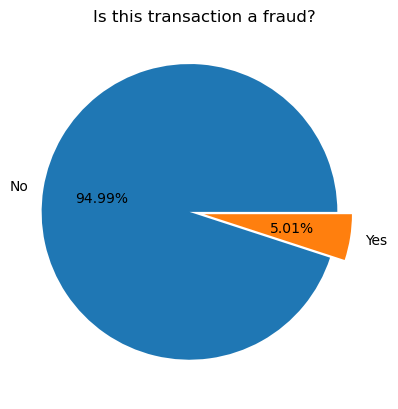

In [19]:
plt.pie(df['Is Fraudulent'].value_counts(), labels=['No', 'Yes'], explode=[0.1,0], autopct="%.2f%%")
plt.title("Is this transaction a fraud?")
plt.show()

> The dataset is clearly imbalanced. We need to find a way to balance the data or we are condemned to only use models that are imbalance-resistant. SMOTE and Under Sampler are one approach, using "class_weight = balanced" while training a model is another but not all models support this.

### Is their a relationship between order value and fraud? 

<Axes: xlabel='Transaction Amount', ylabel='Count'>

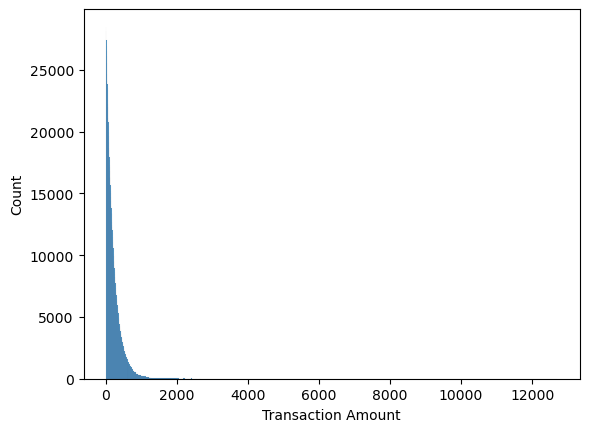

In [20]:
sns.histplot(df["Transaction Amount"])

In [21]:
fig = px.box(df, y="Transaction Amount")
fig.show()

> There is a lot of outliers above $1,000. Let's see their particular relationship to fraud.

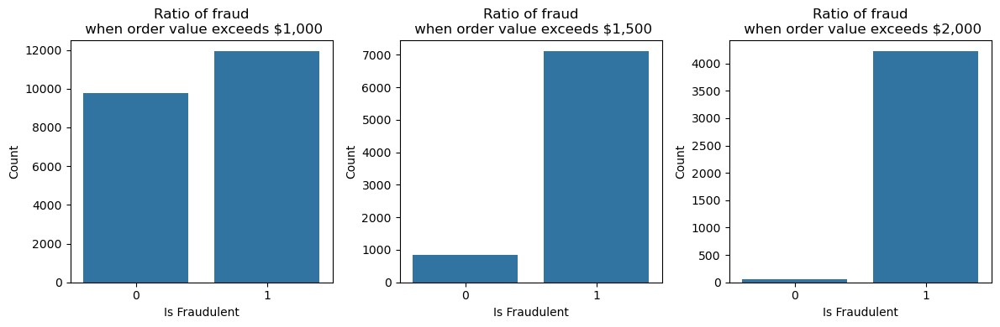

In [22]:
# Subplots
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
axes = axes.ravel() 
        
# Build the plots
sns.countplot(data=df[ df['Transaction Amount'] > 1000], x='Is Fraudulent', ax=axes[0])
sns.countplot(data=df[ df['Transaction Amount'] > 1500], x='Is Fraudulent', ax=axes[1])
sns.countplot(data=df[ df['Transaction Amount'] > 2000], x='Is Fraudulent', ax=axes[2])
axes[0].set_title(f'Ratio of fraud\n when order value exceeds $1,000')
axes[0].set_ylabel('Count')
axes[1].set_title(f'Ratio of fraud\n when order value exceeds $1,500')
axes[1].set_ylabel('Count')
axes[2].set_title(f'Ratio of fraud\n when order value exceeds $2,000')
axes[2].set_ylabel('Count')

# Adjust layout and show plots
plt.tight_layout()
plt.show()

> The number of frauds for order above $1,500 is far exceeding the number of legit orders. At this point, it might be interesting to create and compare two different engineering tactics of the original dataset: one dataset will be using the transaction amount and the other one will be using a binary info of whether the order value is high or not. 

In [23]:
# Fork the datasets at this point: one will use the continuous features, the other the binary features

# Create a new binary feature indicating if an order is above $1,500
df_binary = df.copy()

df_binary['High-value order'] = (df_binary['Transaction Amount'] > 1500).astype(int)
df_binary['High-value order'].sum()

# Remove the Transaction Amount to prevent multicolinearity
#df_binary.drop(columns = ['Transaction Amount'], inplace=True)

7936

<Axes: xlabel='Transaction Amount', ylabel='Count'>

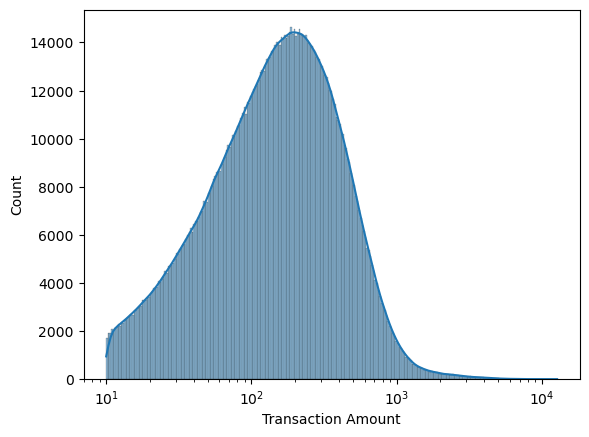

In [24]:
sns.histplot(df["Transaction Amount"], kde=True, log_scale=True)

> A log transformation of the Transaction Amount will unskew the distribution and might improve performance of certain models.

In [25]:
# Downcast the features to save space

# df dataset
int_col = df.select_dtypes(include="int").columns
float_col = df.select_dtypes(include="float").columns
    
df[int_col] = df[int_col].apply(pd.to_numeric, downcast='integer')
df[float_col] = df[float_col].apply(pd.to_numeric, downcast='float')

#df_binary dataset
int_col = df_binary.select_dtypes(include="int").columns
float_col = df_binary.select_dtypes(include="float").columns
    
df_binary[int_col] = df_binary[int_col].apply(pd.to_numeric, downcast='integer')
df_binary[float_col] = df_binary[float_col].apply(pd.to_numeric, downcast='float')



In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1472952 entries, 0 to 1472951
Data columns (total 14 columns):
 #   Column               Non-Null Count    Dtype  
---  ------               --------------    -----  
 0   Transaction Amount   1472952 non-null  float32
 1   Payment Method       1472952 non-null  object 
 2   Product Category     1472952 non-null  object 
 3   Quantity             1472952 non-null  int8   
 4   Customer Age         1472952 non-null  int8   
 5   Customer Location    1472952 non-null  object 
 6   Device Used          1472952 non-null  object 
 7   Is Fraudulent        1472952 non-null  int8   
 8   Account Age Days     1472952 non-null  int16  
 9   Transaction Hour     1472952 non-null  int8   
 10  Transaction Day      1472952 non-null  int8   
 11  Transaction Month    1472952 non-null  int8   
 12  Transaction Weekday  1472952 non-null  int8   
 13  Addresses mismatch   1472952 non-null  int8   
dtypes: float32(1), int16(1), int8(8), object(4)
memory

### What is the relationship of other features with the target?

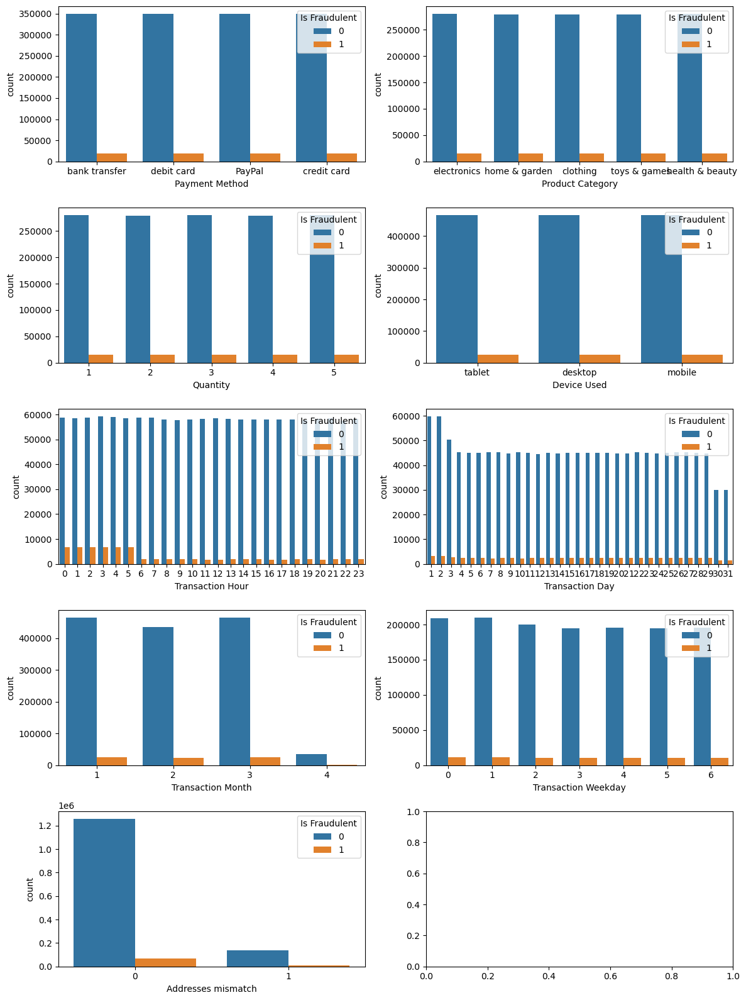

In [27]:
columns = ['Payment Method', 'Product Category', 'Quantity', 'Device Used',
          'Transaction Hour', 'Transaction Day', 'Transaction Month','Transaction Weekday','Addresses mismatch']

# Subplots
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(12, 16))
axes = axes.ravel() 
        
# Build the plots
for idx,col in enumerate(columns):
    sns.countplot(x=col, data=df, hue=df['Is Fraudulent'].astype(str), ax=axes[idx])
    #axes[idx].set_title(f'Ratio of fraud\n when order value exceeds $1,000')
#plt.title('Fraud distribution per quantity')
plt.tight_layout()
plt.show()

> __Observations__<br>
> - The synthetic dataset has been constructed in a way that provides a balanced number of entries per payment method, product category, quantity and device used. 
> - Transaction Month only covers 3 months of data in 2024 and does not seem to provide a lot of informative value regarding fraud patterns. This seems true for Transaction Day and Transaction Weekday as well.
> - Transaction Hour however seems to indicate a higher amount of fraud from midnight to 5am while everyone's asleep.

### Transaction Hour

In [28]:
# Create a new binary feature indicating if the transaction occurred before 6am
df_binary['Is Dawn'] = (df_binary['Transaction Hour'] < 6).astype(int)
df_binary['Is Dawn'].sum()

# Drop the Transaction Hour feature as it is now correlated to Is Dawn
#df_binary.drop(columns = ['Transaction Hour'], inplace=True)

393464

In [29]:
# Let's drop Transaction Month and Transaction Weekday
df.drop(columns = ['Transaction Month', 'Transaction Weekday', 'Transaction Day'], inplace=True)
df_binary.drop(columns = ['Transaction Month', 'Transaction Weekday', 'Transaction Day'], inplace=True)

### Customer Age

<Axes: xlabel='Customer Age', ylabel='Count'>

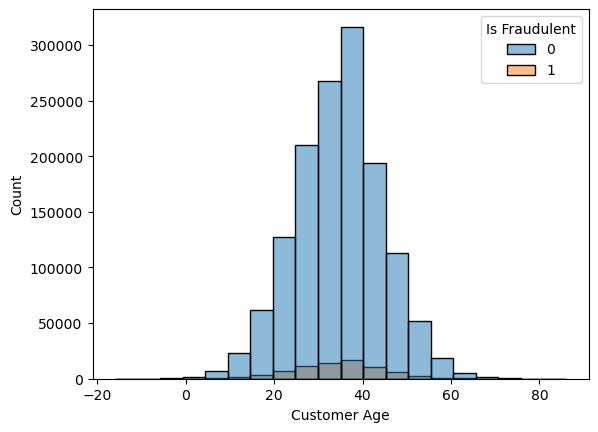

In [30]:
# Check if there is a hidden gem between customer age and fraud
sns.histplot(x="Customer Age", data=df, hue = df['Is Fraudulent'].astype(str), bins = 20)

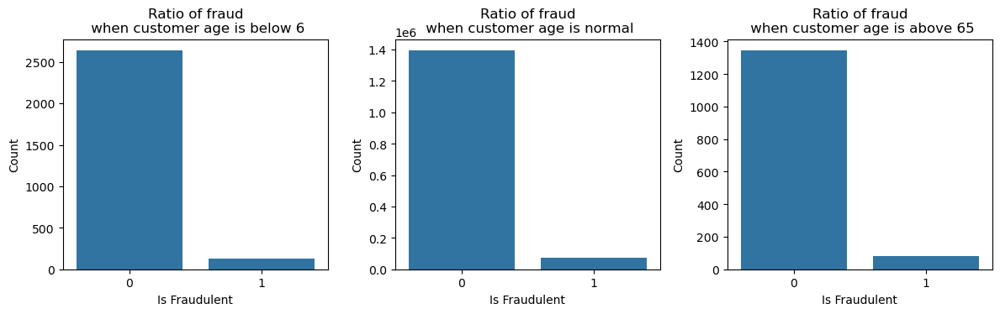

In [31]:
# Subplots
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
axes = axes.ravel() 
        
# Build the plots
sns.countplot(data=df[ df['Customer Age'] < 6], x='Is Fraudulent', ax=axes[0])
sns.countplot(data=df[ (df['Customer Age'] >= 6) & (df['Customer Age'] <= 65)], x='Is Fraudulent', ax=axes[1])
sns.countplot(data=df[ df['Customer Age'] > 65], x='Is Fraudulent', ax=axes[2])
axes[0].set_title(f'Ratio of fraud\n when customer age is below 6')
axes[0].set_ylabel('Count')
axes[1].set_title(f'Ratio of fraud\n when customer age is normal')
axes[1].set_ylabel('Count')
axes[2].set_title(f'Ratio of fraud\n when customer age is above 65')
axes[2].set_ylabel('Count')

# Adjust layout and show plots
plt.tight_layout()
plt.show()

> - Wrong age input could have hinted at a fraud pattern where the fraudster simply fills erroneous info to speed things up. This is not the case here.
> - The distribution being normal, I elect not to clean the wrong ages (negative values and let's say below 13). 

### Device Used and Payment Method

<Axes: xlabel='Payment Method', ylabel='count'>

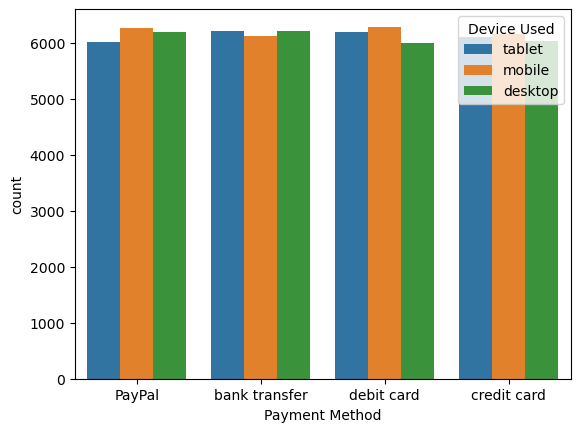

In [32]:
# For fraudulent orders only, is there a specific pattern involving both payment methods and devices?
fraud_df = df[ df['Is Fraudulent'] == 1]

sns.countplot(data=fraud_df, x='Payment Method', hue='Device Used')

> The distribution of fraudulent transactions is even accross payment method and devices. These features are not particularly useful in this synthetic dataset. In real life however, they certainly are. Nevertheless, I elect to keep them and see if the models can uncover something.

### Account Age Days

<Axes: xlabel='Account Age Days', ylabel='Count'>

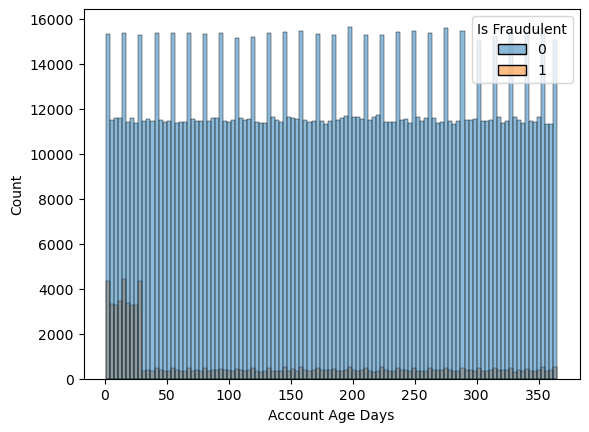

In [33]:
sns.histplot(x="Account Age Days", data=df, hue = df['Is Fraudulent'].astype(str))

> Not surprisingly, new accounts are more likely to be used in a fraud than old ones.

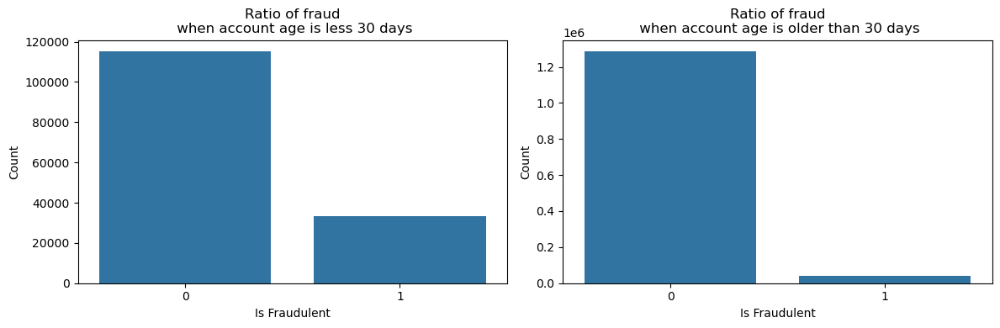

In [34]:
# Subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 4))
axes = axes.ravel() 
        
# Build the plots
sns.countplot(data=df[ df['Account Age Days'] <= 30], x='Is Fraudulent', ax=axes[0])
sns.countplot(data=df[ df['Account Age Days'] > 30], x='Is Fraudulent', ax=axes[1])
axes[0].set_title(f'Ratio of fraud\n when account age is less 30 days')
axes[0].set_ylabel('Count')
axes[1].set_title(f'Ratio of fraud\n when account age is older than 30 days')
axes[1].set_ylabel('Count')


# Adjust layout and show plots
plt.tight_layout()
plt.show()

In [35]:
# Create a new binary feature indicating if the account is younger than 30 days
df_binary['Account Is New'] = (df_binary['Account Age Days'] <= 30).astype(int)
df_binary['Account Is New'].sum()

# Drop the Account Age Days as it's now highly correlated to our binary feature
#df_binary.drop(columns = ['Account Age Days'], inplace=True)

148191

### Customer Location

In [36]:
# Let's check the most popular addresses input by the fraudsters
df[ df['Is Fraudulent'] == 1].groupby('Customer Location')[['Customer Location','Is Fraudulent']].sum().sort_values(by = 'Is Fraudulent', ascending = False).head(20)

,Customer Location,Is Fraudulent
Customer Location,,
East Michael,East MichaelEast MichaelEast MichaelEast Micha...,73
Port Michael,Port MichaelPort MichaelPort MichaelPort Micha...,67
West Michael,West MichaelWest MichaelWest MichaelWest Micha...,63
Lake James,Lake JamesLake JamesLake JamesLake JamesLake J...,57
Lake Jennifer,Lake JenniferLake JenniferLake JenniferLake Je...,56
Lake Michael,Lake MichaelLake MichaelLake MichaelLake Micha...,56
North Michael,North MichaelNorth MichaelNorth MichaelNorth M...,56
New Michael,New MichaelNew MichaelNew MichaelNew MichaelNe...,55
West Jennifer,West JenniferWest JenniferWest JenniferWest Je...,53


> We can see some word patterns in the fraudulent orders. This might either be a clue or just a product of the synthetic dataset. Let's verify.

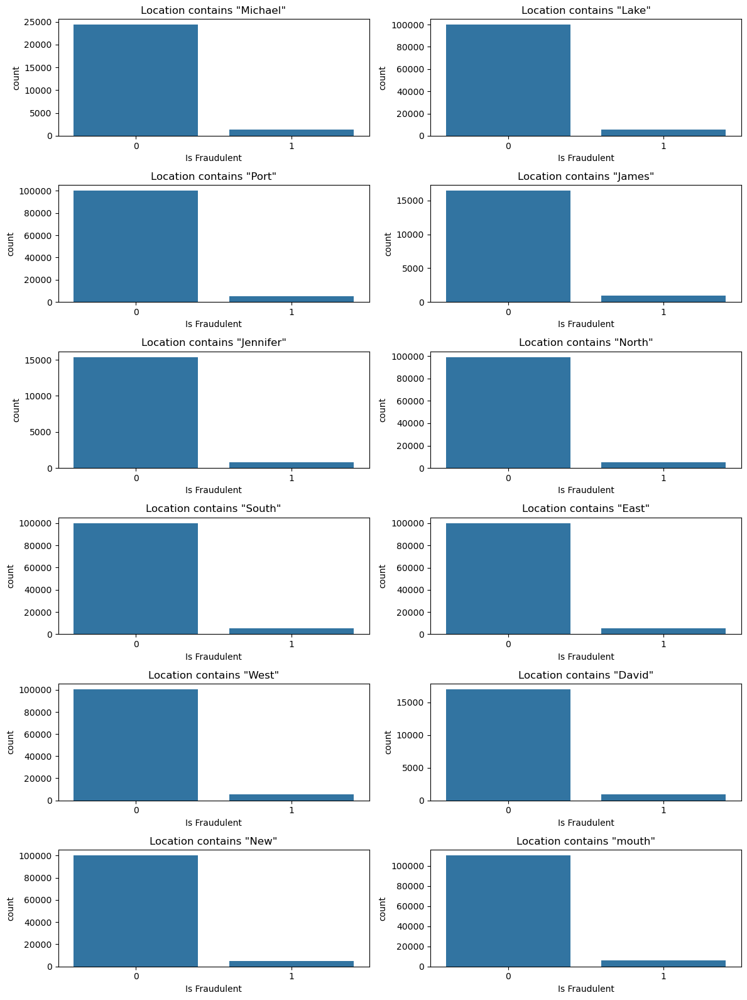

In [37]:
# checking the distribution of these keywords in fraudulent vs non fraudulent orders
keywords = ['Michael', 'Lake', 'Port', 'James', 'Jennifer', 'North', 'South', 'East', 'West', 'David', 'New', 'mouth'] 
# Subplots
fig, axes = plt.subplots(nrows=6, ncols=2, figsize=(12, 16))
axes = axes.ravel() 
        
# Build the plots
for idx,kw in enumerate(keywords):
    kw_df = df[ df['Customer Location'].str.contains(kw)]
    sns.countplot(data=kw_df, x='Is Fraudulent', ax=axes[idx])
    axes[idx].set_title(f'Location contains "{kw}"')

plt.tight_layout()
plt.show()

> Customer Location has been synthetically generated and it appears that no special location keyword stands out as a fraud pattern. Let's remove the feature. 

In [38]:
df.drop(columns = ['Customer Location'], inplace=True)
df_binary.drop(columns = ['Customer Location'], inplace=True)


### Resulting datasets

In [39]:
# Dataset A
df.head()

,Transaction Amount,Payment Method,Product Category,Quantity,Customer Age,Device Used,Is Fraudulent,Account Age Days,Transaction Hour,Addresses mismatch
0,58.090000,bank transfer,electronics,1,17,tablet,0,30,5,0
1,389.959991,debit card,electronics,2,40,desktop,0,72,8,0
2,134.190002,PayPal,home & garden,2,22,tablet,0,63,3,0
3,226.169998,bank transfer,clothing,5,31,desktop,0,124,20,0
4,121.529999,bank transfer,clothing,2,51,tablet,0,158,5,0


In [40]:
# Dataset B
df_binary.head()

,Transaction Amount,Payment Method,Product Category,Quantity,Customer Age,Device Used,Is Fraudulent,Account Age Days,Transaction Hour,Addresses mismatch,High-value order,Is Dawn,Account Is New
0,58.090000,bank transfer,electronics,1,17,tablet,0,30,5,0,0,1,1
1,389.959991,debit card,electronics,2,40,desktop,0,72,8,0,0,0,0
2,134.190002,PayPal,home & garden,2,22,tablet,0,63,3,0,0,1,0
3,226.169998,bank transfer,clothing,5,31,desktop,0,124,20,0,0,0,0
4,121.529999,bank transfer,clothing,2,51,tablet,0,158,5,0,0,1,0


# <br>3. PREPROCESSING AND FEATURE ENGINEERING

## <br><center>PREPARE AND BALANCE THE DATASETS</center>

### Preprocessing of Dataset A

In [41]:
# Transform the dataset
df_transformed = df.copy()
# OHE
#df_transformed = pd.get_dummies(df, columns=['Payment Method','Product Category','Device Used'], drop_first = True)

# encoder = TargetEncoder()
# df_transformed['Payment Method'] = encoder.fit_transform(df[['Payment Method']], df['Is Fraudulent'])
# df_transformed['Product Category'] = encoder.fit_transform(df[['Product Category']], df['Is Fraudulent'])
# df_transformed['Device Used'] = encoder.fit_transform(df[['Device Used']], df['Is Fraudulent'])

encoder = LabelEncoder()
df_transformed['Payment Method'] = encoder.fit_transform(df['Payment Method'])
df_transformed['Product Category'] = encoder.fit_transform(df['Product Category'])
df_transformed['Device Used'] = encoder.fit_transform(df['Device Used'])


# Log transform
df_transformed['Transaction Amount'] = np.log1p(df_transformed['Transaction Amount'])

# Scale
scaler = StandardScaler()
to_scale = ['Transaction Amount','Quantity','Customer Age','Account Age Days', 'Transaction Hour',
            'Payment Method', 'Product Category', 'Device Used']
df_transformed[to_scale] = scaler.fit_transform(df_transformed[to_scale])

df_transformed.head()

,Transaction Amount,Payment Method,Product Category,Quantity,Customer Age,Device Used,Is Fraudulent,Account Age Days,Transaction Hour,Addresses mismatch
0,-0.834141,-0.447597,-0.706601,-1.413854,-1.750660,1.224664,0,-1.400342,-0.901229,0
1,0.994897,1.341482,-0.706601,-0.707008,0.548620,-1.225773,0,-1.007320,-0.471182,0
2,-0.033023,-1.342137,0.708229,-0.707008,-1.250816,1.224664,0,-1.091539,-1.187926,0
3,0.469375,-0.447597,-1.414016,1.413529,-0.351098,-1.225773,0,-0.520721,1.249003,0
4,-0.128200,-0.447597,-1.414016,-0.707008,1.648276,1.224664,0,-0.202560,-0.901229,0


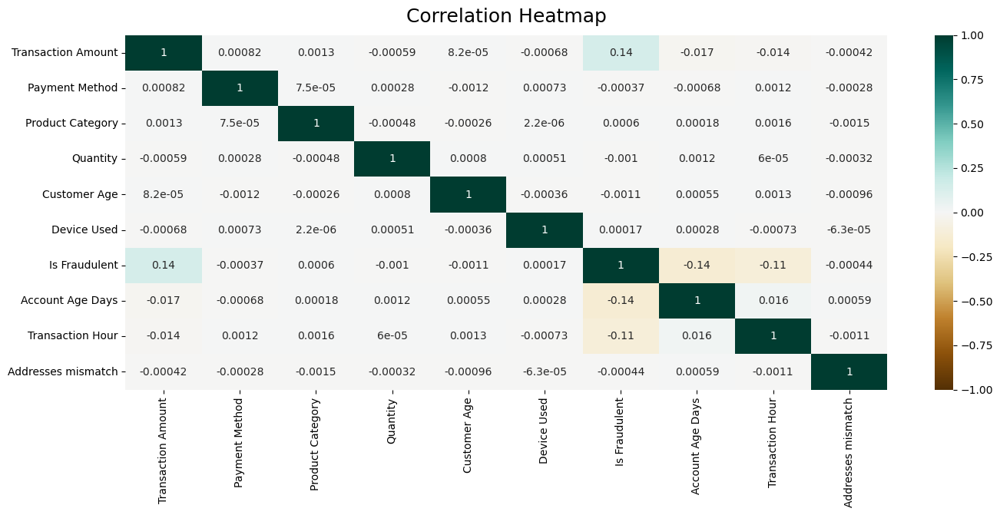

In [42]:
plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(df_transformed.select_dtypes(include='number').corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=12);

In [43]:
df_transformed.select_dtypes(include='number').corr()

,Transaction Amount,Payment Method,Product Category,Quantity,Customer Age,Device Used,Is Fraudulent,Account Age Days,Transaction Hour,Addresses mismatch
Transaction Amount,1.000000,0.000821,0.001290,-0.000589,0.000082,-0.000679,0.135758,-0.017069,-0.014055,-0.000420
Payment Method,0.000821,1.000000,0.000075,0.000277,-0.001194,0.000729,-0.000373,-0.000682,0.001187,-0.000276
Product Category,0.001290,0.000075,1.000000,-0.000475,-0.000264,0.000002,0.000596,0.000177,0.001553,-0.001511
Quantity,-0.000589,0.000277,-0.000475,1.000000,0.000803,0.000510,-0.001027,0.001212,0.000060,-0.000318
Customer Age,0.000082,-0.001194,-0.000264,0.000803,1.000000,-0.000361,-0.001129,0.000545,0.001311,-0.000955
Device Used,-0.000679,0.000729,0.000002,0.000510,-0.000361,1.000000,0.000166,0.000278,-0.000732,-0.000063
Is Fraudulent,0.135758,-0.000373,0.000596,-0.001027,-0.001129,0.000166,1.000000,-0.136188,-0.112821,-0.000438
Account Age Days,-0.017069,-0.000682,0.000177,0.001212,0.000545,0.000278,-0.136188,1.000000,0.016409,0.000595
Transaction Hour,-0.014055,0.001187,0.001553,0.000060,0.001311,-0.000732,-0.112821,0.016409,1.000000,-0.001064
Addresses mismatch,-0.000420,-0.000276,-0.001511,-0.000318,-0.000955,-0.000063,-0.000438,0.000595,-0.001064,1.000000


In [44]:
# Let's lower dimensionality to the most important features only using an L1 penalty

selector = ''
best_features = ''

params = {'C' : [0.01,0.1,1,10,100],
         'solver': ['liblinear']}
df_small = df_transformed.sample(frac=0.5)
A,b = df_small.drop(columns='Is Fraudulent'), df_small['Is Fraudulent']

grid_lr = GridSearchCV(estimator = LogisticRegression(penalty = 'l1', class_weight='balanced'), 
                       scoring = 'roc_auc', param_grid = params).fit(A,b)

selector = SelectFromModel(estimator=grid_lr.best_estimator_, max_features = 5).fit(A,b)
best_features = selector.get_feature_names_out()
print(grid_lr.best_params_)
print(selector.get_feature_names_out())

{'C': 0.01, 'solver': 'liblinear'}
['Transaction Amount' 'Customer Age' 'Account Age Days' 'Transaction Hour'
 'Addresses mismatch']


In [45]:
# Let's keep a smaller dataset A
best_features = selector.get_feature_names_out().tolist()
best_features.append('Is Fraudulent')
df_A = df_transformed[best_features]
df_A.head()

,Transaction Amount,Customer Age,Account Age Days,Transaction Hour,Addresses mismatch,Is Fraudulent
0,-0.834141,-1.750660,-1.400342,-0.901229,0,0
1,0.994897,0.548620,-1.007320,-0.471182,0,0
2,-0.033023,-1.250816,-1.091539,-1.187926,0,0
3,0.469375,-0.351098,-0.520721,1.249003,0,0
4,-0.128200,1.648276,-0.202560,-0.901229,0,0


### 2-dimensional PCA on dataset A

In [ ]:
# Reduce the dimensionality to 2
pca = PCA(n_components=2)

df2 = pd.DataFrame(pca.fit_transform(df_transformed.drop(columns='Is Fraudulent')))
# merge last column of default

df2[2] = df_transformed['Is Fraudulent']

fig = px.scatter(df2,x=0,y=1,color=2,title="Scatter plot of the main 2 principal components", labels={"0":"Component 1", "1":"Component 2", "2":"Is Fraudulent"})
fig.show()

print(pca.explained_variance_ratio_)

The scatter plot adds 160MB to the notebook size, so I cleared the output cell and I'm adding the PNG instead:
<img src='./img/pca_a.png'/>

### 3-dimensional PCA on dataset A

In [47]:
# Reduce the dimensionality to 3
pca_3 = PCA(n_components=3)

df3 = pd.DataFrame(pca_3.fit_transform(df_transformed.drop(columns='Is Fraudulent')))
# merge last column of default

df3[3] = df_transformed['Is Fraudulent']

print(pca_3.explained_variance_ratio_)

[0.12753813 0.12380752 0.12373529]


### Preprocessing of dataset B

In [48]:
df_binary.head()

,Transaction Amount,Payment Method,Product Category,Quantity,Customer Age,Device Used,Is Fraudulent,Account Age Days,Transaction Hour,Addresses mismatch,High-value order,Is Dawn,Account Is New
0,58.090000,bank transfer,electronics,1,17,tablet,0,30,5,0,0,1,1
1,389.959991,debit card,electronics,2,40,desktop,0,72,8,0,0,0,0
2,134.190002,PayPal,home & garden,2,22,tablet,0,63,3,0,0,1,0
3,226.169998,bank transfer,clothing,5,31,desktop,0,124,20,0,0,0,0
4,121.529999,bank transfer,clothing,2,51,tablet,0,158,5,0,0,1,0


In [49]:
# Transform the dataset 2
df_binary_transformed = df_binary.copy()
# OHE
df_binary_transformed = pd.get_dummies(df_binary, columns=['Payment Method','Product Category','Device Used'])

# encoder = TargetEncoder()
# df_transformed['Payment Method'] = encoder.fit_transform(df[['Payment Method']], df['Is Fraudulent'])
# df_transformed['Product Category'] = encoder.fit_transform(df[['Product Category']], df['Is Fraudulent'])
# df_transformed['Device Used'] = encoder.fit_transform(df[['Device Used']], df['Is Fraudulent'])


# Log transform
df_binary_transformed['Transaction Amount'] = np.log1p(df_binary_transformed['Transaction Amount'])

# Scale
scaler = StandardScaler()
to_scale = ['Transaction Amount','Quantity','Customer Age','Account Age Days','Transaction Hour']
df_binary_transformed[to_scale] = scaler.fit_transform( df_binary_transformed[to_scale] )

df_binary_transformed.head()

,Transaction Amount,Quantity,Customer Age,Is Fraudulent,Account Age Days,Transaction Hour,Addresses mismatch,High-value order,Is Dawn,Account Is New,...,Payment Method_credit card,Payment Method_debit card,Product Category_clothing,Product Category_electronics,Product Category_health & beauty,Product Category_home & garden,Product Category_toys & games,Device Used_desktop,Device Used_mobile,Device Used_tablet
0,-0.834141,-1.413854,-1.750660,0,-1.400342,-0.901229,0,0,1,1,...,False,False,False,True,False,False,False,False,False,True
1,0.994897,-0.707008,0.548620,0,-1.007320,-0.471182,0,0,0,0,...,False,True,False,True,False,False,False,True,False,False
2,-0.033023,-0.707008,-1.250816,0,-1.091539,-1.187926,0,0,1,0,...,False,False,False,False,False,True,False,False,False,True
3,0.469375,1.413529,-0.351098,0,-0.520721,1.249003,0,0,0,0,...,False,False,True,False,False,False,False,True,False,False
4,-0.128200,-0.707008,1.648276,0,-0.202560,-0.901229,0,0,1,0,...,False,False,True,False,False,False,False,False,False,True


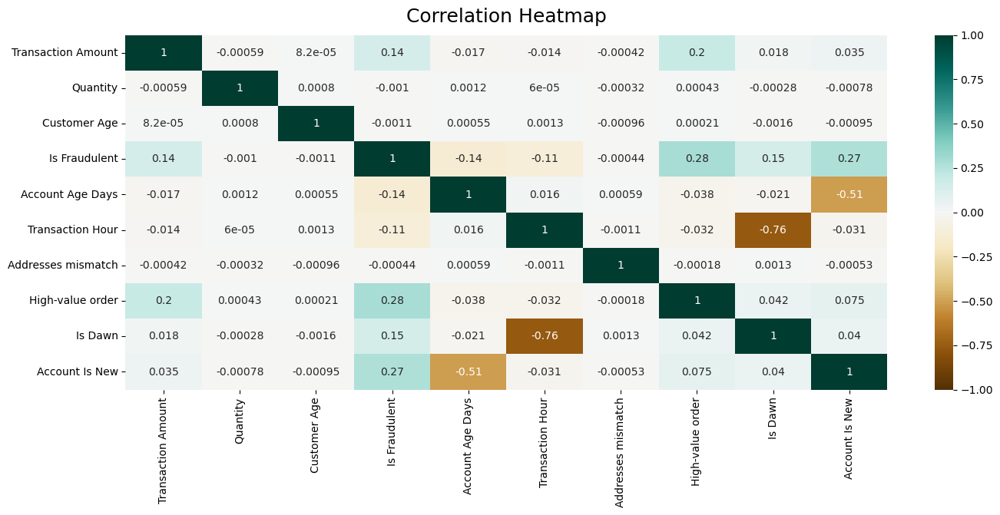

In [50]:
plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(df_binary_transformed.select_dtypes(include='number').corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=12);

In [51]:
# Let's lower dimensionality to the most important features only using an L1 penalty

selector = ''
best_features = ''

params = {'C' : [0.01,1,100],
         'solver': ['liblinear']}
df_small = df_binary_transformed.sample(frac=0.2)
A,b = df_small.drop(columns='Is Fraudulent'), df_small['Is Fraudulent']

grid_lr = GridSearchCV(estimator = LogisticRegression(penalty = 'l1', class_weight='balanced', max_iter=10000), 
                       scoring = 'roc_auc', param_grid = params).fit(A,b)

selector = SelectFromModel(estimator=grid_lr.best_estimator_, max_features = 6).fit(A,b)
best_features = selector.get_feature_names_out()
print(selector.get_feature_names_out())

['Transaction Amount' 'Transaction Hour' 'High-value order' 'Is Dawn'
 'Account Is New' 'Product Category_electronics']


In [52]:
# Let's keep a smaller dataset B
best_features = selector.get_feature_names_out().tolist()
best_features.append('Is Fraudulent')
df_B = df_binary_transformed[best_features]
df_B.head()

,Transaction Amount,Transaction Hour,High-value order,Is Dawn,Account Is New,Product Category_electronics,Is Fraudulent
0,-0.834141,-0.901229,0,1,1,True,0
1,0.994897,-0.471182,0,0,0,True,0
2,-0.033023,-1.187926,0,1,0,False,0
3,0.469375,1.249003,0,0,0,False,0
4,-0.128200,-0.901229,0,1,0,False,0


### PCA on dataset B

In [ ]:
# Reduce the dimensionality to 2
pca = PCA(n_components=2)

df2_B = pd.DataFrame(pca.fit_transform(df_binary_transformed.drop(columns='Is Fraudulent')))
# merge last column of default

df2_B[2] = df_binary_transformed['Is Fraudulent']

fig = px.scatter(df2_B,x=0,y=1,color=2,title="Scatter plot of the main 2 principal components", labels={"0":"Component 1", "1":"Component 2", "2":"Is Fraudulent"})
fig.show()

print(pca.explained_variance_ratio_)

The scatter plot increases the size of the notebook by 160MB, so I cleared the cell's ouput and I'm adding the png instead:
<img src='./img/pca_b.png' />

### 3-dimensional PCA on dataset B

In [54]:
# Reduce the dimensionality to 3
pca_3 = PCA(n_components=3)

df3_B = pd.DataFrame(pca_3.fit_transform(df_binary_transformed.drop(columns='Is Fraudulent')))
# merge last column of default

df3_B[3] = df_binary_transformed['Is Fraudulent']

print(pca_3.explained_variance_ratio_)

[0.1486103  0.13538788 0.13170667]


### Split dataset A and rebalance the training set

In [66]:
# Because of the computation power required, I will only use a fraction of the complete datasets
df_A_tiny = df_A.sample(frac=0.4)

In [67]:
X = df_A_tiny.drop('Is Fraudulent', axis = 1)
y = df_A_tiny['Is Fraudulent']
X.shape, y.shape

((589181, 5), (589181,))

In [68]:
# Let's split into training and test sets before rebalancing the training set
X_train_imbalanced, X_test, y_train_imbalanced, y_test = train_test_split(X, y, test_size=0.1, random_state=42, stratify=y)

In [69]:
# Over and Under sampling with imblearn. Credits to https://machinelearningmastery.com/smote-oversampling-for-imbalanced-classification/ 
# Here I decide to use a hybrid strategy to handle the imbalance: I will not SMOTE and under sample to a true 50/50 
# but rather keep the minority class as a minority and use class_weight=balanced
# Credits to: https://link.springer.com/article/10.1186/s40537-019-0192-5#Sec2
over = SMOTE(sampling_strategy=0.1)
X_over, y_over = over.fit_resample(X_train_imbalanced, y_train_imbalanced)

under = RandomUnderSampler(sampling_strategy=0.75)
X_train, y_train = under.fit_resample(X_over,y_over)


In [70]:
X_train.shape, y_train.shape

((117551, 5), (117551,))

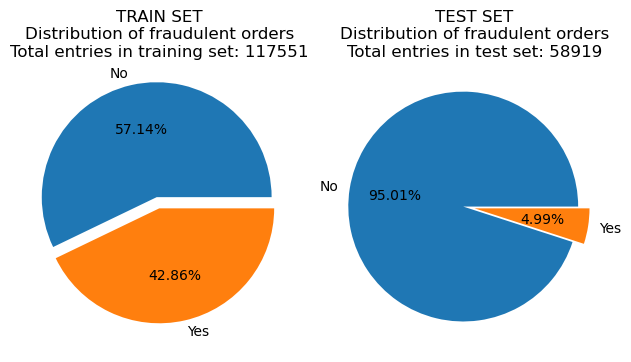

In [71]:
plt.subplot(1, 2, 1)
plt.pie(y_train.value_counts(), labels=['No', 'Yes'], explode=[0.1,0], autopct="%.2f%%")
plt.title(f"TRAIN SET\nDistribution of fraudulent orders\nTotal entries in training set: {X_train.shape[0]}")
plt.subplot(1, 2, 2)
plt.pie(y_test.value_counts(), labels=['No', 'Yes'], explode=[0.1,0], autopct="%.2f%%")
plt.title(f"TEST SET\nDistribution of fraudulent orders\nTotal entries in test set: {X_test.shape[0]}")

plt.tight_layout()
plt.show()


### Split 2-D PCA dataset A and rebalance the training set

In [72]:
df2.head()

,0,1,2
0,0.971599,-1.277792,0
1,1.460719,0.005977,0
2,1.346865,-0.571763,0
3,-0.149060,0.964897,0
4,0.525603,1.101971,0


In [73]:
# Because of the computation power required, I will only use a fraction of the complete datasets
df2_A_tiny = df2.sample(frac=0.4)

X2 = df2_A_tiny.drop(2, axis = 1)
y2 = df2_A_tiny[2]
X2.shape, y2.shape

((589181, 2), (589181,))

In [74]:
# Let's split into training and test sets before rebalancing the training set
X2_train_imbalanced, X2_test, y2_train_imbalanced, y2_test = train_test_split(X2, y2, test_size=0.1, random_state=42, stratify=y2)

In [75]:
# Over and Under sampling with imblearn. Credits to https://machinelearningmastery.com/smote-oversampling-for-imbalanced-classification/ 
# Here I decide to use a hybrid strategy to handle the imbalance: I will not SMOTE and under sample to a true 50/50 
# but rather keep the minority class as a minority and use class_weight=balanced
# Credits to: https://link.springer.com/article/10.1186/s40537-019-0192-5#Sec2
over = SMOTE(sampling_strategy=0.1)
X2_over, y2_over = over.fit_resample(X2_train_imbalanced, y2_train_imbalanced)

under = RandomUnderSampler(sampling_strategy=0.75)
X2_train, y2_train = under.fit_resample(X2_over,y2_over)

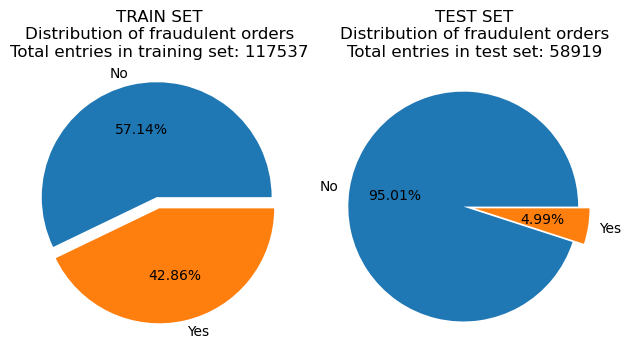

In [76]:
plt.subplot(1, 2, 1)
plt.pie(y_train.value_counts(), labels=['No', 'Yes'], explode=[0.1,0], autopct="%.2f%%")
plt.title(f"TRAIN SET\nDistribution of fraudulent orders\nTotal entries in training set: {X2_train.shape[0]}")
plt.subplot(1, 2, 2)
plt.pie(y_test.value_counts(), labels=['No', 'Yes'], explode=[0.1,0], autopct="%.2f%%")
plt.title(f"TEST SET\nDistribution of fraudulent orders\nTotal entries in test set: {X2_test.shape[0]}")

plt.tight_layout()
plt.show()

### Split dataset B and rebalance the training set

In [77]:
df_B_tiny_b = df_B.sample(frac=0.4)

In [78]:
X_b = df_B_tiny_b.drop('Is Fraudulent', axis = 1)
y_b = df_B_tiny_b['Is Fraudulent']
X_b.shape, y_b.shape

((589181, 6), (589181,))

In [79]:
# Let's split dataset B into train and test sets before rebalancing the training dataset
X_train_imbalanced_b, X_test_b, y_train_imbalanced_b, y_test_b = train_test_split(X_b, y_b, test_size=0.1, random_state=42, stratify=y_b)

In [80]:
# Over and Under sampling with imblearn. Credits to https://machinelearningmastery.com/smote-oversampling-for-imbalanced-classification/ 
# Here I decide to use a hybrid strategy to handle the imbalance: I will not SMOTE and under sample to a true 50/50 
# but rather keep the minority class as a minority and use class_weight=balanced
# Credits to: https://link.springer.com/article/10.1186/s40537-019-0192-5#Sec2
over = SMOTE(sampling_strategy=0.1)
X_b_over, y_b_over = over.fit_resample(X_train_imbalanced_b, y_train_imbalanced_b)

under = RandomUnderSampler(sampling_strategy=0.75)
X_train_b, y_train_b = under.fit_resample(X_b_over,y_b_over)
#X_rebalanced, y_rebalanced = under.fit_resample(X,y)

In [81]:
X_train_b.shape, y_train_b.shape

((117569, 6), (117569,))

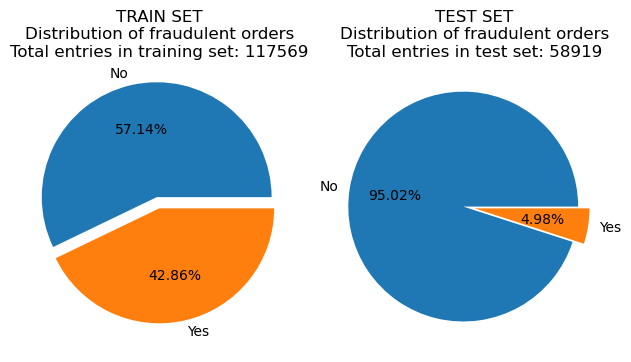

In [82]:
plt.subplot(1, 2, 1)
plt.pie(y_train_b.value_counts(), labels=['No', 'Yes'], explode=[0.1,0], autopct="%.2f%%")
plt.title(f"TRAIN SET\nDistribution of fraudulent orders\nTotal entries in training set: {X_train_b.shape[0]}")
plt.subplot(1, 2, 2)
plt.pie(y_test_b.value_counts(), labels=['No', 'Yes'], explode=[0.1,0], autopct="%.2f%%")
plt.title(f"TEST SET\nDistribution of fraudulent orders\nTotal entries in test set: {X_test_b.shape[0]}")

plt.tight_layout()
plt.show()


In [83]:
X_train_b.head()

,Transaction Amount,Transaction Hour,High-value order,Is Dawn,Account Is New,Product Category_electronics
415787,1.034150,1.679049,0,0,0,False
263548,-0.552319,-1.474624,0,1,0,False
498073,0.417337,1.535701,0,0,0,False
45578,0.213104,-1.331275,0,1,0,False
464842,-0.002228,1.249003,0,0,0,False


# <br>4. MODELING

## <br><center>MODELS PERFORMANCE ON DATASET A</center>

In [84]:
# Function that returns the scores for a certain probability threshold
# Takes a target array, a prediction array for 0 and 1 and a threshold
# Returns the accuracy, precision, recall and ROC scores for that threshold 

def get_scores_by_threshold(y_test, preds, thresh = .5):
    if (preds.shape[1] == 2):
        new_preds = np.where(preds[:, 1] > thresh, 1,0)
    else:
        new_preds = np.where(preds > thresh, 1,0)
    fpr, tpr, thr = roc_curve(y_test, new_preds)
    return (round(accuracy_score(y_test, new_preds),6),
            round(precision_score(y_test,new_preds,zero_division=0),6), 
            round(recall_score(y_test,new_preds,zero_division=0),6), 
            round(roc_auc_score(y_test,new_preds),6), 
            fpr, tpr)


### Baseline model performance

In [85]:
# Baseline model score
dummy_pipe = Pipeline([
    ('model',DummyClassifier())
])

dummy_pipe.fit(X_train,y_train)
baseline_score = dummy_pipe.score(X_test,y_test)
print(f'Accuracy: {round(baseline_score,3)}')
print(f'Recall: {recall_score(y_test,dummy_pipe.predict(X_test),zero_division=0)}')
print(f'Precision: {precision_score(y_test,dummy_pipe.predict(X_test),zero_division=0)}')

print(classification_report(y_test,dummy_pipe.predict(X_test),zero_division=0))

Accuracy: 0.95
Recall: 0.0
Precision: 0.0
              precision    recall  f1-score   support

           0       0.95      1.00      0.97     55978
           1       0.00      0.00      0.00      2941

    accuracy                           0.95     58919
   macro avg       0.48      0.50      0.49     58919
weighted avg       0.90      0.95      0.93     58919



In [86]:
dummy_pipe.predict_proba(X_test).shape

(58919, 2)

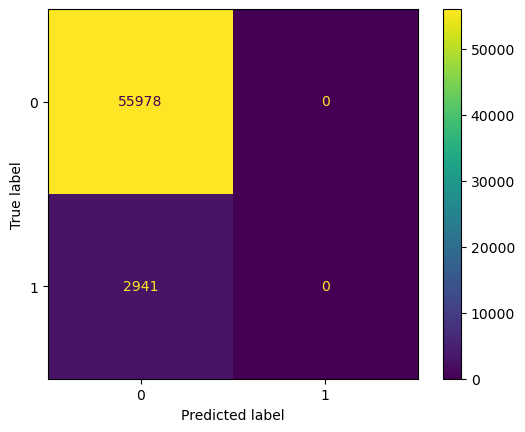

In [87]:
mid_preds = np.where(dummy_pipe.predict_proba(X_test)[:, 1] > 0.5, 1,0)
mat = ConfusionMatrixDisplay.from_predictions(y_test,mid_preds)

> Due to the imbalanced nature of the dataset, the accuracy metric will not be the best metric to evaluate the performance of the models. We will give a preference to the recall metric to see how many true frauds the models are capable to detect without generating too many false positive (precision). Therefore, optimizing for the PR AUC or ROC AUC metrics seems a good compromise. We will then calibrate the probability threshold to make the model more optimistic and classify more positives. Generally speaking, in fraud detection, we want to detect more frauds as they are more costly to merchants (cost of the goods, of the shipping, of the labor, chargeback penalty, etc.). False positive are generally handled via other solutions: self authorization via text message and/or a manual verification queue where fraud agents reach out to the customer whose order is pending. 

### Logistic Regression performance

In [88]:
# Grid search best hyperparameters
params = {'C' : [0.01,0.1,1,10,100,1000],
         'solver' : ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']}

start = time.time()
grid_lr = GridSearchCV(estimator = LogisticRegression(max_iter=1000000, class_weight='balanced'), 
                       scoring = 'average_precision', param_grid = params)

# Fit on training set
grid_lr.fit(X_train,y_train)
lr_searchfit_time = time.time() - start

# Predict
start = time.time()
lr_y_pred = grid_lr.best_estimator_.predict_proba(X_test)
lr_inference_time = time.time() - start

# Results
lr_best_k = grid_lr.best_params_
lr_train_acc = grid_lr.score(X_train,y_train)

print(f'Best parameters: {lr_best_k}')
print(f'Train accuracy: {round(lr_train_acc,6)}')
print(f'Search+Fit time: {round(lr_searchfit_time,6)}s')
print(f'Inference time: {round(lr_inference_time,6)}s')

Best parameters: {'C': 0.01, 'solver': 'newton-cg'}
Train accuracy: 0.724732
Search+Fit time: 25.023337s
Inference time: 0.002s


In [89]:
# Results
lr_test_recall = recall_score(y_test,grid_lr.best_estimator_.predict(X_test))
lr_test_precision = precision_score(y_test,grid_lr.best_estimator_.predict(X_test))

print(f'Test recall: {round(lr_test_recall,6)}')
print(f'Test precision: {round(lr_test_precision,6)}')

print(classification_report(y_test,grid_lr.best_estimator_.predict(X_test)))

Test recall: 0.687181
Test precision: 0.102928
              precision    recall  f1-score   support

           0       0.98      0.69      0.81     55978
           1       0.10      0.69      0.18      2941

    accuracy                           0.69     58919
   macro avg       0.54      0.69      0.49     58919
weighted avg       0.93      0.69      0.77     58919



### KNN performance

In [90]:
# Grid search best hyperparameters
params2 = {'n_neighbors' : [300,500],
          'p' : [1],
          'weights' : ['uniform','distance']}

start = time.time()
grid_knn = GridSearchCV(estimator = KNeighborsClassifier(), scoring = 'average_precision', param_grid = params2)

# Fit on training set
grid_knn.fit(X_train.values,y_train)
knn_searchfit_time = time.time() - start

# Predict
start = time.time()
knn_y_pred = grid_knn.best_estimator_.predict_proba(X_test.values)
knn_inference_time = time.time() - start

# Results
knn_best_k = grid_knn.best_params_
knn_train_acc = grid_knn.score(X_train.values,y_train) 
knn_test_acc = grid_knn.score(X_test.values,y_test)

print(f'Best parameters: {knn_best_k}')
print(f'Train accuracy: {round(knn_train_acc,6)}')
print(f'Test accuracy: {round(knn_test_acc,6)}')
print(f'Search+Fit time: {round(knn_searchfit_time,6)}s')
print(f'Inference time: {round(knn_inference_time,6)}s')

Best parameters: {'n_neighbors': 300, 'p': 1, 'weights': 'distance'}
Train accuracy: 1.0
Test accuracy: 0.342781
Search+Fit time: 75.597039s
Inference time: 8.230441s


In [91]:
knn_test_recall = recall_score(y_test,grid_knn.best_estimator_.predict(X_test.values))
knn_test_precision = precision_score(y_test,grid_knn.best_estimator_.predict(X_test.values))

print(f'Test recall: {round(knn_test_recall,6)}')
print(f'Test precision: {round(knn_test_precision,6)}')

print(classification_report(y_test,grid_knn.best_estimator_.predict(X_test.values)))

Test recall: 0.593676
Test precision: 0.181214
              precision    recall  f1-score   support

           0       0.98      0.86      0.91     55978
           1       0.18      0.59      0.28      2941

    accuracy                           0.85     58919
   macro avg       0.58      0.73      0.60     58919
weighted avg       0.94      0.85      0.88     58919



### Decision Tree performance

In [92]:
# Grid search best hyperparameters
params = {'max_depth': [10,15,20,25,None],
         'min_samples_split': [2,5,10,15,20],
          'criterion': ['gini','entropy','log_loss'],
          'min_samples_leaf': [1,2,5,10,15,20]
         }

start = time.time()
#grid_tree = GridSearchCV(estimator = DecisionTreeClassifier(random_state = 42), scoring = 'accuracy', param_grid=params).fit(X_train,y_train)
grid_tree = RandomizedSearchCV(estimator = DecisionTreeClassifier(random_state = 42, class_weight='balanced'), 
                               scoring = 'average_precision', param_distributions=params, n_iter=300)

# Fit on training set
grid_tree.fit(X_train,y_train)
tree_searchfit_time = time.time() - start

# Predict
start = time.time()
dt_y_pred = grid_tree.best_estimator_.predict_proba(X_test)
tree_inference_time = time.time() - start

# Results
tree_best_k = grid_tree.best_params_
tree_train_acc = grid_tree.score(X_train,y_train)
tree_test_acc = grid_tree.score(X_test,y_test)

print(f'Best parameters: {tree_best_k}')
print(f'Train accuracy: {round(tree_train_acc,6)}')
print(f'Test accuracy: {round(tree_test_acc,6)}')
print(f'Search+Fit time: {round(tree_searchfit_time,6)}s')
print(f'Inference time: {round(tree_inference_time,6)}s')



Best parameters: {'min_samples_split': 10, 'min_samples_leaf': 20, 'max_depth': 25, 'criterion': 'gini'}
Train accuracy: 0.887834
Test accuracy: 0.270643
Search+Fit time: 1109.60044s
Inference time: 0.010001s


In [93]:
print(classification_report(y_test,grid_tree.best_estimator_.predict(X_test)))

              precision    recall  f1-score   support

           0       0.98      0.81      0.89     55978
           1       0.15      0.62      0.24      2941

    accuracy                           0.80     58919
   macro avg       0.56      0.71      0.56     58919
weighted avg       0.93      0.80      0.85     58919



### Gradient Boosting Ensemble performance

In [94]:
# Grid search best hyperparameters
params = {'max_depth': [1,2,3,4],
          'max_iter': [200,500,1000,2000],
          'min_samples_leaf': [1,5,10,20,50]
         }

start = time.time()
grid_gboost = GridSearchCV(estimator = HistGradientBoostingClassifier(class_weight='balanced'), 
                           scoring = 'roc_auc', param_grid = params)

# Fit on training set
grid_gboost.fit(X_train,y_train)
gboost_searchfit_time = time.time() - start

# Predict
start = time.time()
gboost_y_pred = grid_gboost.best_estimator_.predict_proba(X_test)
gboost_inference_time = time.time() - start

# Results
gboost_best_k = grid_gboost.best_params_
gboost_train_acc = grid_gboost.score(X_train,y_train)
gboost_test_acc = grid_gboost.score(X_test,y_test)

print(f'Best parameters: {gboost_best_k}')
print(f'Train accuracy: {round(gboost_train_acc,6)}')
print(f'Test accuracy: {round(gboost_test_acc,6)}')
print(f'Search+Fit time: {round(gboost_searchfit_time,6)}s')
print(f'Inference time: {round(gboost_inference_time,6)}s')


Best parameters: {'max_depth': 4, 'max_iter': 1000, 'min_samples_leaf': 1}
Train accuracy: 0.890989
Test accuracy: 0.807543
Search+Fit time: 615.535571s
Inference time: 0.462115s


In [95]:
print(classification_report(y_test,grid_gboost.best_estimator_.predict(X_test)))

              precision    recall  f1-score   support

           0       0.98      0.88      0.92     55978
           1       0.20      0.58      0.30      2941

    accuracy                           0.86     58919
   macro avg       0.59      0.73      0.61     58919
weighted avg       0.94      0.86      0.89     58919



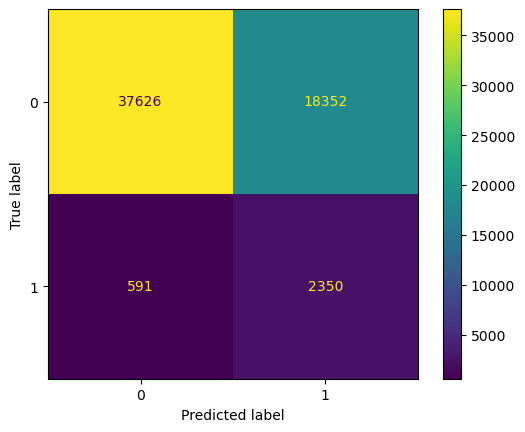

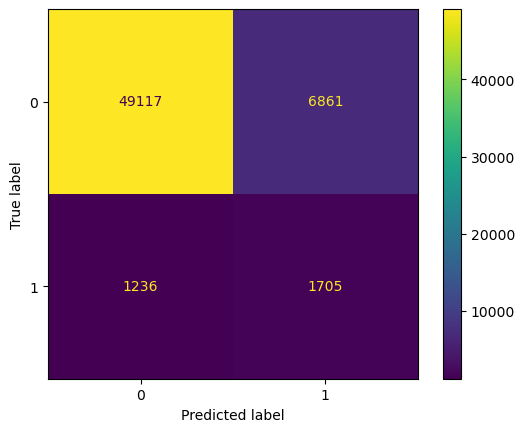

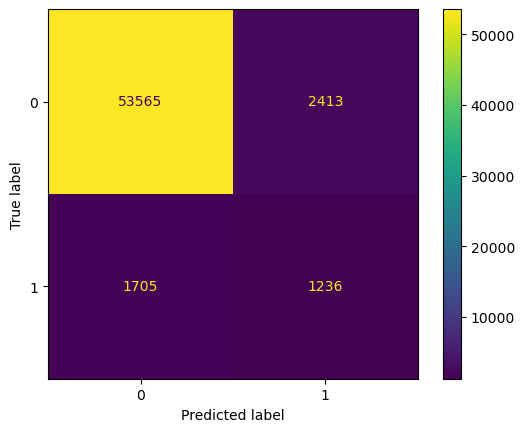

In [96]:
low_preds = np.where(gboost_y_pred[:, 1] > 0.3, 1,0)
mid_preds = np.where(gboost_y_pred[:, 1] > 0.5, 1,0)
high_preds = np.where(gboost_y_pred[:, 1] > 0.7, 1,0)

mat_low = ConfusionMatrixDisplay.from_predictions(y_test,low_preds)
mat = ConfusionMatrixDisplay.from_predictions(y_test,mid_preds)
mat_high = ConfusionMatrixDisplay.from_predictions(y_test,high_preds)

In [97]:
# Get scores from various thresholds
Ts = np.round(np.linspace(.1, .9, 9),2)
Accs = []
Ps = []
Rs = []
ROCs = []
FPRs = []
TPRs = []

for t in Ts:
    a, p, r, roc, fpr, tpr = get_scores_by_threshold(y_test, gboost_y_pred, thresh = t)
    Accs.append(a)
    Ps.append(p)
    Rs.append(r)
    ROCs.append(roc)
    FPRs.append(fpr)
    TPRs.append(tpr)
#    print(f'scores {round(t*100,2)}%: {a} {p} {r} {roc}')
end = time.time()

df_dict = {
    'Threshold':Ts,
    'Accuracy':Accs,
    'Precision':Ps,
    'Recall':Rs,
    'ROC':ROCs
}

gboost_df = pd.DataFrame(df_dict).set_index('Threshold')
gboost_df

,Accuracy,Precision,Recall,ROC
Threshold,,,,
0.1,0.089071,0.051506,0.990479,0.516096
0.2,0.518729,0.083210,0.862632,0.681646
0.3,0.678491,0.113516,0.799048,0.735602
0.4,0.768139,0.138570,0.698742,0.735264
0.5,0.862574,0.199043,0.579735,0.728584
0.6,0.900423,0.252788,0.508671,0.714838
0.7,0.930107,0.338723,0.420265,0.688579
0.8,0.942005,0.406447,0.351581,0.662303
0.9,0.953241,0.596074,0.196192,0.594603


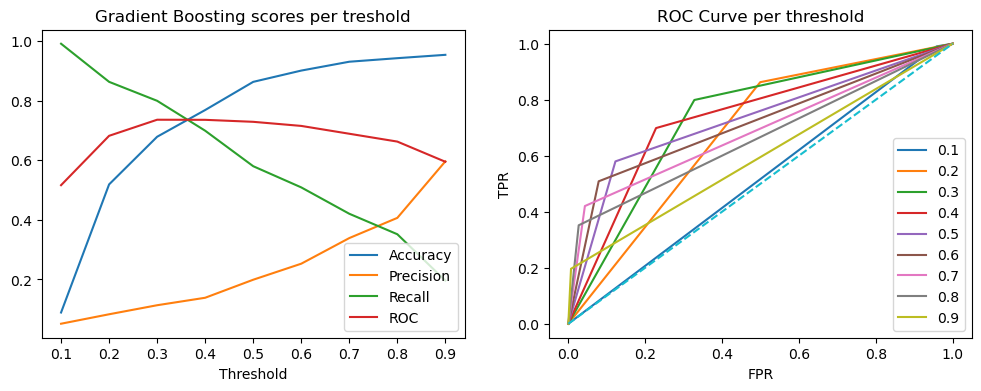

In [98]:
# Visualize how Gradient Boosting performs on various metrics and thresholds

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 4))
axes = axes.ravel() 

gboost_df.plot(ax = axes[0])
axes[0].set_title("Gradient Boosting scores per treshold")

for f,t in zip(FPRs,TPRs):
    axes[1].plot(f,t)
axes[1].plot([0,1],[0,1],'--') 
axes[1].set_xlabel("FPR")
axes[1].set_ylabel("TPR")
axes[1].set_title("ROC Curve per threshold")
axes[1].legend(Ts)
plt.show()

### Random Forest performance

In [99]:
# Grid search best hyperparameters
params = {'n_estimators': [600],
          'max_features':[0.8],
          'min_samples_leaf':[3,5,10],
          'max_samples':[0.5],
         }

start = time.time()
grid_forest = GridSearchCV(estimator = RandomForestClassifier(random_state = 42, class_weight='balanced'), 
                           scoring = 'average_precision', param_grid=params)
#grid_forest = RandomizedSearchCV(estimator = DecisionTreeClassifier(random_state = 42), scoring = 'roc_auc', param_distributions=params,n_iter=270)

# Fit on training set
grid_forest.fit(X_train,y_train)
forest_searchfit_time = time.time() - start

# Predict
start = time.time()
forest_y_pred = grid_forest.best_estimator_.predict_proba(X_test)
forest_inference_time = time.time() - start

# Results
forest_best_k = grid_forest.best_params_
forest_train_acc = grid_forest.score(X_train,y_train)
forest_test_acc = grid_forest.score(X_test,y_test)

print(f'Best parameters: {forest_best_k}')
print(f'Train accuracy: {round(forest_train_acc,6)}')
print(f'Test accuracy: {round(forest_test_acc,6)}')
print(f'Search+Fit time: {round(forest_searchfit_time,6)}s')
print(f'Inference time: {round(forest_inference_time,6)}s')


Best parameters: {'max_features': 0.8, 'max_samples': 0.5, 'min_samples_leaf': 3, 'n_estimators': 600}
Train accuracy: 0.967301
Test accuracy: 0.350992
Search+Fit time: 2669.597389s
Inference time: 6.389631s


In [100]:
best_forest_y_pred = grid_forest.best_estimator_.predict(X_test)
print(classification_report(y_test,best_forest_y_pred))

              precision    recall  f1-score   support

           0       0.98      0.88      0.92     55978
           1       0.20      0.58      0.29      2941

    accuracy                           0.86     58919
   macro avg       0.59      0.73      0.61     58919
weighted avg       0.94      0.86      0.89     58919



### Deep Neural Network performance

In [101]:
model = Sequential([
    Input(shape=X_train.shape[1:]),
    Dense(256, activation="relu"),
    Dense(256, activation="relu"),
    Dropout(0.3),
    Dense(256, activation="relu"),
    Dropout(0.3),
    Dense(1, activation="sigmoid"),
])

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 256)            │         1,536 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 133,377 (521.00 KB)

 Trainable params: 133,377 (521.00 KB)

 Non-trainable params: 0 (0.00 B)

In [102]:
metrics = [
    keras.metrics.FalseNegatives(name="fn"),
    keras.metrics.FalsePositives(name="fp"),
    keras.metrics.TrueNegatives(name="tn"),
    keras.metrics.TruePositives(name="tp"),
    keras.metrics.Precision(name="precision"),
    keras.metrics.Recall(name="recall"),
    keras.metrics.AUC(name='auc'),
    keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
]

model.compile(
    optimizer=keras.optimizers.Adam(1e-2), loss="binary_crossentropy", metrics=metrics
)

callbacks = [keras.callbacks.ModelCheckpoint("fraud_model_at_epoch_{epoch}.keras")]
weight_for_0 = 1.0
weight_for_1 = 2.0
class_weight = {0: weight_for_0, 1: weight_for_1}

start = time.time()
baseline_history = model.fit(
    X_train,
    y_train,
    batch_size=2048,
    epochs=50,
    verbose=2,
#    callbacks=callbacks,
    validation_data=(X_test, y_test),
#    class_weight=class_weight
)
dnn_searchfit_time = time.time() - start

Epoch 1/50
58/58 - 5s - 78ms/step - auc: 0.7554 - fn: 22306.0000 - fp: 12120.0000 - loss: 0.5770 - prc: 0.7193 - precision: 0.6985 - recall: 0.5572 - tn: 55052.0000 - tp: 28073.0000 - val_auc: 0.8000 - val_fn: 1210.0000 - val_fp: 7962.0000 - val_loss: 0.4701 - val_prc: 0.3421 - val_precision: 0.1786 - val_recall: 0.5886 - val_tn: 48016.0000 - val_tp: 1731.0000
Epoch 2/50
58/58 - 0s - 8ms/step - auc: 0.8046 - fn: 21047.0000 - fp: 8388.0000 - loss: 0.5185 - prc: 0.7888 - precision: 0.7776 - recall: 0.5822 - tn: 58784.0000 - tp: 29332.0000 - val_auc: 0.8070 - val_fn: 1270.0000 - val_fp: 6580.0000 - val_loss: 0.4086 - val_prc: 0.3573 - val_precision: 0.2025 - val_recall: 0.5682 - val_tn: 49398.0000 - val_tp: 1671.0000
Epoch 3/50
58/58 - 0s - 8ms/step - auc: 0.8076 - fn: 20671.0000 - fp: 8382.0000 - loss: 0.5149 - prc: 0.7917 - precision: 0.7799 - recall: 0.5897 - tn: 58790.0000 - tp: 29708.0000 - val_auc: 0.8078 - val_fn: 1172.0000 - val_fp: 7713.0000 - val_loss: 0.4290 - val_prc: 0.3597 -

Epoch 24/50
58/58 - 0s - 8ms/step - auc: 0.8140 - fn: 19959.0000 - fp: 8500.0000 - loss: 0.5049 - prc: 0.8004 - precision: 0.7816 - recall: 0.6038 - tn: 58672.0000 - tp: 30420.0000 - val_auc: 0.8093 - val_fn: 1238.0000 - val_fp: 6815.0000 - val_loss: 0.4217 - val_prc: 0.3635 - val_precision: 0.1999 - val_recall: 0.5791 - val_tn: 49163.0000 - val_tp: 1703.0000
Epoch 25/50
58/58 - 0s - 8ms/step - auc: 0.8149 - fn: 20019.0000 - fp: 8386.0000 - loss: 0.5042 - prc: 0.8013 - precision: 0.7836 - recall: 0.6026 - tn: 58786.0000 - tp: 30360.0000 - val_auc: 0.8105 - val_fn: 1203.0000 - val_fp: 7156.0000 - val_loss: 0.4086 - val_prc: 0.3650 - val_precision: 0.1954 - val_recall: 0.5910 - val_tn: 48822.0000 - val_tp: 1738.0000
Epoch 26/50
58/58 - 0s - 8ms/step - auc: 0.8153 - fn: 19896.0000 - fp: 8481.0000 - loss: 0.5042 - prc: 0.8012 - precision: 0.7823 - recall: 0.6051 - tn: 58691.0000 - tp: 30483.0000 - val_auc: 0.8100 - val_fn: 1271.0000 - val_fp: 6467.0000 - val_loss: 0.4131 - val_prc: 0.3662 

Epoch 47/50
58/58 - 0s - 8ms/step - auc: 0.8171 - fn: 19745.0000 - fp: 8587.0000 - loss: 0.5021 - prc: 0.8032 - precision: 0.7811 - recall: 0.6081 - tn: 58585.0000 - tp: 30634.0000 - val_auc: 0.8100 - val_fn: 1223.0000 - val_fp: 6832.0000 - val_loss: 0.4046 - val_prc: 0.3651 - val_precision: 0.2009 - val_recall: 0.5842 - val_tn: 49146.0000 - val_tp: 1718.0000
Epoch 48/50
58/58 - 0s - 8ms/step - auc: 0.8174 - fn: 19726.0000 - fp: 8539.0000 - loss: 0.5019 - prc: 0.8035 - precision: 0.7821 - recall: 0.6084 - tn: 58633.0000 - tp: 30653.0000 - val_auc: 0.8105 - val_fn: 1171.0000 - val_fp: 7327.0000 - val_loss: 0.4211 - val_prc: 0.3681 - val_precision: 0.1946 - val_recall: 0.6018 - val_tn: 48651.0000 - val_tp: 1770.0000
Epoch 49/50
58/58 - 0s - 8ms/step - auc: 0.8171 - fn: 19749.0000 - fp: 8614.0000 - loss: 0.5023 - prc: 0.8028 - precision: 0.7805 - recall: 0.6080 - tn: 58558.0000 - tp: 30630.0000 - val_auc: 0.8106 - val_fn: 1256.0000 - val_fp: 6418.0000 - val_loss: 0.4007 - val_prc: 0.3702 

In [103]:
def plot_metrics(history):
  metrics = ['loss', 'prc', 'precision', 'recall']
  for n, metric in enumerate(metrics):
    name = metric.replace("_"," ").capitalize()
    plt.subplot(2,2,n+1)
    plt.plot(history.epoch, history.history[metric], label='Train')
    plt.plot(history.epoch, history.history['val_'+metric], linestyle="--", label='Val')
    plt.xlabel('Epoch')
    plt.ylabel(name)
    if metric == 'loss':
      plt.ylim([0, plt.ylim()[1]])
    elif metric == 'auc':
      plt.ylim([0.8,1])
    else:
      plt.ylim([0,1])

    plt.legend()

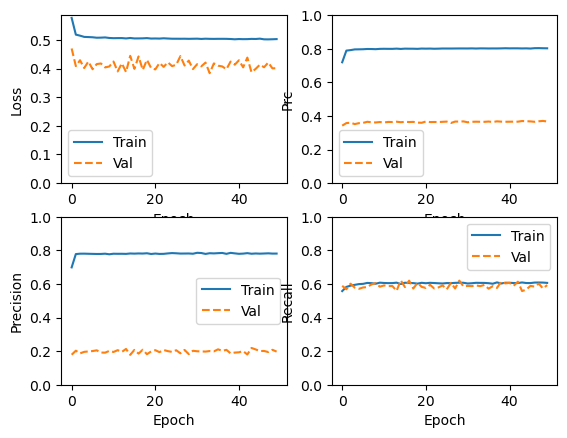

In [104]:
plot_metrics(baseline_history)

In [105]:
def plot_cm(labels, predictions, threshold=0.5):
  cm = confusion_matrix(labels, predictions > threshold)
  plt.figure(figsize=(5,5))
  sns.heatmap(cm, annot=True, fmt="d", cmap='coolwarm')
  plt.title('Confusion matrix @{:.2f}'.format(threshold))
  plt.ylabel('Actual label')
  plt.xlabel('Predicted label')

  print('Legitimate Transactions Detected (True Negatives): ', cm[0][0])
  print('Legitimate Transactions Incorrectly Detected (False Positives): ', cm[0][1])
  print('Fraudulent Transactions Missed (False Negatives): ', cm[1][0])
  print('Fraudulent Transactions Detected (True Positives): ', cm[1][1])
  print('Total Fraudulent Transactions: ', np.sum(cm[1]))

In [106]:
train_predictions = model.predict(X_train, batch_size=2048)
start = time.time()
test_predictions = model.predict(X_test, batch_size=2048)
dnn_inference_time = time.time() - start

58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


loss :  0.4012688398361206
compile_metrics :  1197.0

Legitimate Transactions Detected (True Negatives):  48867
Legitimate Transactions Incorrectly Detected (False Positives):  7111
Fraudulent Transactions Missed (False Negatives):  1197
Fraudulent Transactions Detected (True Positives):  1744
Total Fraudulent Transactions:  2941


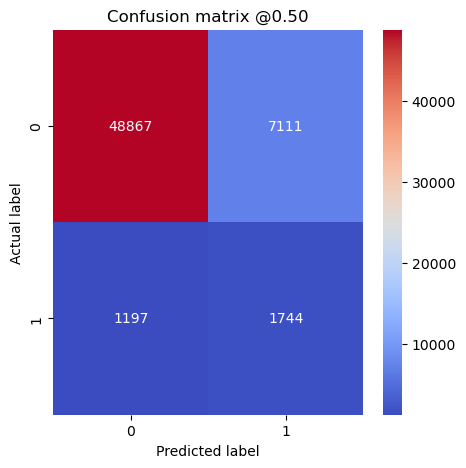

In [107]:
results = model.evaluate(X_test, y_test, batch_size=2048, verbose=0)
for name, value in zip(model.metrics_names, results):
  print(name, ': ', value)
print()
plot_cm(y_test, test_predictions)


Legitimate Transactions Detected (True Negatives):  36005
Legitimate Transactions Incorrectly Detected (False Positives):  19973
Fraudulent Transactions Missed (False Negatives):  534
Fraudulent Transactions Detected (True Positives):  2407
Total Fraudulent Transactions:  2941
Legitimate Transactions Detected (True Negatives):  40170
Legitimate Transactions Incorrectly Detected (False Positives):  15808
Fraudulent Transactions Missed (False Negatives):  697
Fraudulent Transactions Detected (True Positives):  2244
Total Fraudulent Transactions:  2941


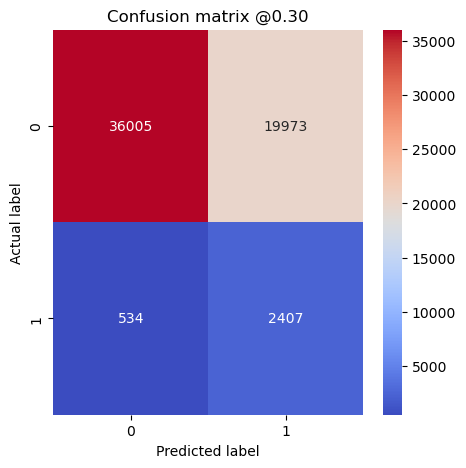

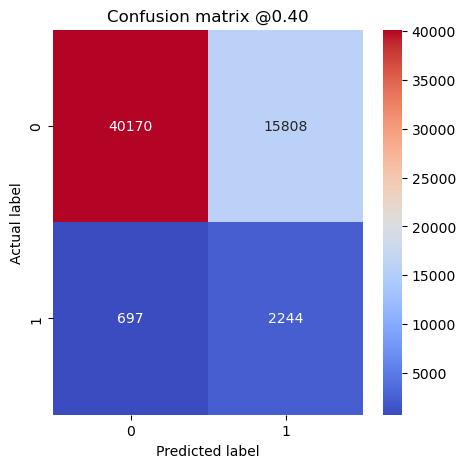

In [108]:
plot_cm(y_test, test_predictions, threshold=0.3)
plot_cm(y_test, test_predictions, threshold=0.4)

In [109]:
# Get scores from various thresholds
Ts = np.round(np.linspace(.1, .9, 9),2)
Accs = []
Ps = []
Rs = []
ROCs = []
FPRs = []
TPRs = []

for t in Ts:
    a, p, r, roc, fpr, tpr = get_scores_by_threshold(y_test, test_predictions, thresh = t)
    Accs.append(a)
    Ps.append(p)
    Rs.append(r)
    ROCs.append(roc)
    FPRs.append(fpr)
    TPRs.append(tpr)
#    print(f'scores {round(t*100,2)}%: {a} {p} {r} {roc}')
end = time.time()

df_dict = {
    'Threshold':Ts,
    'Accuracy':Accs,
    'Precision':Ps,
    'Recall':Rs,
    'ROC':ROCs
}

dnn_df = pd.DataFrame(df_dict).set_index('Threshold')
dnn_df

,Accuracy,Precision,Recall,ROC
Threshold,,,,
0.1,0.091498,0.051526,0.988099,0.516246
0.2,0.579609,0.093095,0.849031,0.707243
0.3,0.651946,0.107551,0.818429,0.730814
0.4,0.719870,0.124308,0.763006,0.740305
0.5,0.858993,0.196951,0.592996,0.732982
0.6,0.889323,0.231070,0.522951,0.715761
0.7,0.934266,0.358273,0.400544,0.681425
0.8,0.941835,0.408371,0.368242,0.670107
0.9,0.954819,0.683311,0.176811,0.586253


## <br><center>MODELS PERFORMANCE ON DATASET B</center>

### Logistic Regression

In [110]:
# Grid search best hyperparameters
params = {'C' : [0.01,0.1,1,10,100,1000],
         'solver' : ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']}

start = time.time()
grid_lr_b = GridSearchCV(estimator = LogisticRegression(max_iter=10000,class_weight='balanced'), 
                         scoring = 'average_precision', param_grid = params)

# Fit on training set
grid_lr_b.fit(X_train_b,y_train_b)
lr_searchfit_time_b = time.time() - start

# Predict
start = time.time()
lr_y_pred_b = grid_lr_b.best_estimator_.predict_proba(X_test_b)
lr_inference_time_b = time.time() - start

# Results
lr_best_k_b = grid_lr_b.best_params_
lr_train_acc_b = grid_lr_b.score(X_train_b,y_train_b)
lr_test_acc_b = grid_lr_b.score(X_test_b,y_test_b)

print(f'Best parameters: {lr_best_k_b}')
print(f'Train accuracy: {round(lr_train_acc_b,6)}')
print(f'Test accuracy: {round(lr_test_acc_b,6)}')
print(f'Search+Fit time: {round(lr_searchfit_time_b,6)}s')
print(f'Inference time: {round(lr_inference_time_b,6)}s')


Best parameters: {'C': 0.1, 'solver': 'newton-cholesky'}
Train accuracy: 0.798604
Test accuracy: 0.372578
Search+Fit time: 28.735046s
Inference time: 0.001998s


In [111]:
print(classification_report(y_test_b,grid_lr_b.best_estimator_.predict(X_test_b)))

              precision    recall  f1-score   support

           0       0.98      0.77      0.86     55987
           1       0.14      0.72      0.23      2932

    accuracy                           0.76     58919
   macro avg       0.56      0.74      0.55     58919
weighted avg       0.94      0.76      0.83     58919



In [112]:
# Get scores from various thresholds
Ts = np.round(np.linspace(.1, .9, 9),2)
Accs = []
Ps = []
Rs = []
ROCs = []
FPRs = []
TPRs = []

for t in Ts:
    a, p, r, roc, fpr, tpr = get_scores_by_threshold(y_test_b, lr_y_pred_b, thresh = t)
    Accs.append(a)
    Ps.append(p)
    Rs.append(r)
    ROCs.append(roc)
    FPRs.append(fpr)
    TPRs.append(tpr)
#    print(f'scores {round(t*100,2)}%: {a} {p} {r} {roc}')
end = time.time()

df_dict = {
    'Threshold':Ts,
    'Accuracy':Accs,
    'Precision':Ps,
    'Recall':Rs,
    'ROC':ROCs
}

lr_df_b = pd.DataFrame(df_dict).set_index('Threshold')
lr_df_b

,Accuracy,Precision,Recall,ROC
Threshold,,,,
0.1,0.049797,0.049765,1.000000,0.500018
0.2,0.250004,0.059963,0.958731,0.585810
0.3,0.575434,0.093000,0.860505,0.710505
0.4,0.709584,0.121913,0.779673,0.742793
0.5,0.762759,0.138026,0.718281,0.741685
0.6,0.850897,0.190022,0.611869,0.737642
0.7,0.913508,0.285573,0.491473,0.713542
0.8,0.940019,0.394386,0.383356,0.676264
0.9,0.949914,0.493875,0.261255,0.623617


### KNN

In [113]:
# Grid search best hyperparameters
params2 = {'n_neighbors' : [5,10,15,20,25,30,35],
          'p' : [1,2],
          'weights' : ['uniform','distance']}

start = time.time()
grid_knn_b = GridSearchCV(estimator = KNeighborsClassifier(), scoring = 'average_precision', param_grid = params2)

# Fit on training set
grid_knn_b.fit(X_train_b.values,y_train_b)
knn_searchfit_time_b = time.time() - start

# Predict
start = time.time()
knn_y_pred_b = grid_knn_b.best_estimator_.predict_proba(X_test_b.values)
knn_inference_time_b = time.time() - start

# Results
knn_best_k_b = grid_knn_b.best_params_
knn_train_acc_b = grid_knn_b.score(X_train_b.values,y_train_b) 
knn_test_acc_b = grid_knn_b.score(X_test_b.values,y_test_b)

print(f'Best parameters: {knn_best_k_b}')
print(f'Train accuracy: {round(knn_train_acc_b,6)}')
print(f'Test accuracy: {round(knn_test_acc_b,6)}')
print(f'Search+Fit time: {round(knn_searchfit_time_b,6)}s')
print(f'Inference time: {round(knn_inference_time_b,6)}s')

Best parameters: {'n_neighbors': 35, 'p': 1, 'weights': 'uniform'}
Train accuracy: 0.821157
Test accuracy: 0.338199
Search+Fit time: 61.399337s
Inference time: 1.178005s


In [114]:
print(classification_report(y_test_b,grid_knn_b.best_estimator_.predict(X_test_b.values)))

              precision    recall  f1-score   support

           0       0.98      0.84      0.90     55987
           1       0.17      0.64      0.27      2932

    accuracy                           0.83     58919
   macro avg       0.57      0.74      0.59     58919
weighted avg       0.94      0.83      0.87     58919



### Decision Tree

In [115]:
# Grid search best hyperparameters
params = {'max_depth': [5,10,15,20,None],
         'min_samples_split': [2,5,10,15,20],
          'criterion': ['gini','entropy','log_loss'],
          'min_samples_leaf': [1,2,5,10,15,20]
         }

start = time.time()
#grid_tree = GridSearchCV(estimator = DecisionTreeClassifier(random_state = 42), scoring = 'accuracy', param_grid=params).fit(X_train,y_train)
grid_tree_b = RandomizedSearchCV(estimator = DecisionTreeClassifier(random_state = 42, class_weight = 'balanced'), 
                                 scoring = 'average_precision', param_distributions = params, n_iter = 300)

# Fit on training set
grid_tree_b.fit(X_train_b,y_train_b)
tree_searchfit_time_b = time.time() - start

# Predict
start = time.time()
dt_y_pred_b = grid_tree_b.best_estimator_.predict_proba(X_test_b)
tree_inference_time_b = time.time() - start

# Results
tree_best_k_b = grid_tree_b.best_params_
tree_train_acc_b = grid_tree_b.score(X_train_b,y_train_b)
tree_test_acc_b = grid_tree_b.score(X_test_b,y_test_b)

print(f'Best parameters: {tree_best_k_b}')
print(f'Train accuracy: {round(tree_train_acc_b,6)}')
print(f'Test accuracy: {round(tree_test_acc_b,6)}')
print(f'Search+Fit time: {round(tree_searchfit_time_b,6)}s')
print(f'Inference time: {round(tree_inference_time_b,6)}s')

Best parameters: {'min_samples_split': 15, 'min_samples_leaf': 20, 'max_depth': 10, 'criterion': 'entropy'}
Train accuracy: 0.808667
Test accuracy: 0.3387
Search+Fit time: 555.536671s
Inference time: 0.006004s


In [116]:
print(classification_report(y_test_b,grid_tree_b.best_estimator_.predict(X_test_b)))

              precision    recall  f1-score   support

           0       0.98      0.75      0.85     55987
           1       0.13      0.74      0.23      2932

    accuracy                           0.75     58919
   macro avg       0.56      0.74      0.54     58919
weighted avg       0.94      0.75      0.82     58919



### Gradient Boosting Ensemble

In [117]:
# Grid search best hyperparameters
params = {'max_depth': [1,2,3,4],
          'max_iter': [200,500,1000,2000],
          'min_samples_leaf': [5,10,20,50]
         }

start = time.time()
grid_gboost_b = GridSearchCV(estimator = HistGradientBoostingClassifier(class_weight='balanced'), 
                             scoring = 'average_precision', param_grid = params)

# Fit on training set
grid_gboost_b.fit(X_train_b,y_train_b)
gboost_searchfit_time_b = time.time() - start

# Predict
start = time.time()
gboost_y_pred_b = grid_gboost_b.best_estimator_.predict_proba(X_test_b)
gboost_inference_time_b = time.time() - start

# Results
gboost_best_k_b = grid_gboost_b.best_params_
gboost_train_acc_b = grid_gboost_b.score(X_train_b,y_train_b)
gboost_test_acc_b = grid_gboost_b.score(X_test_b,y_test_b)

print(f'Best parameters: {gboost_best_k_b}')
print(f'Train accuracy: {round(gboost_train_acc_b,6)}')
print(f'Test accuracy: {round(gboost_test_acc_b,6)}')
print(f'Search+Fit time: {round(gboost_searchfit_time_b,6)}s')
print(f'Inference time: {round(gboost_inference_time_b,6)}s')

Best parameters: {'max_depth': 4, 'max_iter': 2000, 'min_samples_leaf': 20}
Train accuracy: 0.811002
Test accuracy: 0.384841
Search+Fit time: 147.007716s
Inference time: 0.083045s


In [118]:
print(classification_report(y_test_b,grid_gboost_b.best_estimator_.predict(X_test_b)))

              precision    recall  f1-score   support

           0       0.98      0.77      0.86     55987
           1       0.14      0.73      0.24      2932

    accuracy                           0.77     58919
   macro avg       0.56      0.75      0.55     58919
weighted avg       0.94      0.77      0.83     58919



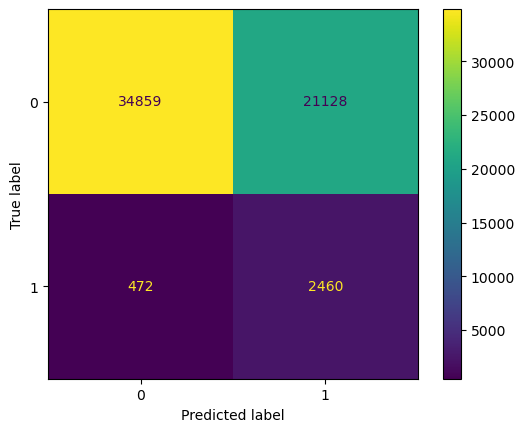

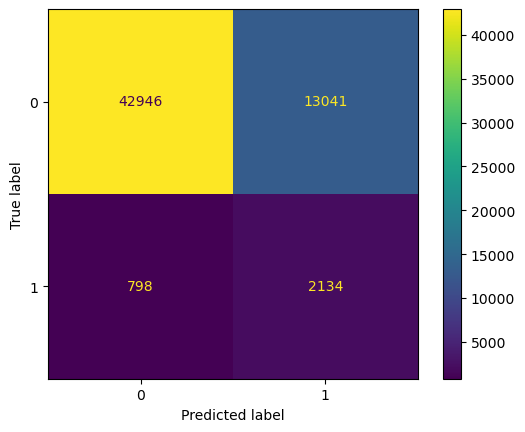

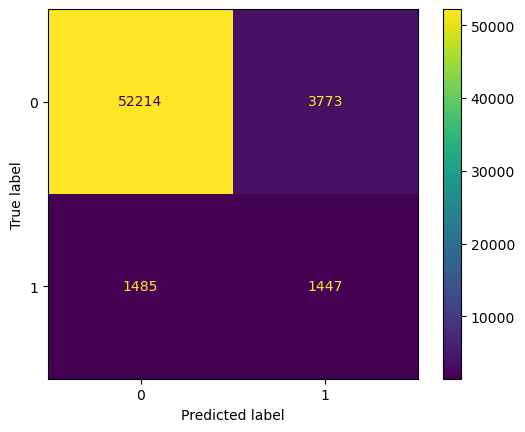

In [119]:
low_preds = np.where(gboost_y_pred_b[:, 1] > 0.3, 1,0)
mid_preds = np.where(gboost_y_pred_b[:, 1] > 0.5, 1,0)
high_preds = np.where(gboost_y_pred_b[:, 1] > 0.7, 1,0)

mat_low = ConfusionMatrixDisplay.from_predictions(y_test_b,low_preds)
mat = ConfusionMatrixDisplay.from_predictions(y_test_b,mid_preds)
mat_high = ConfusionMatrixDisplay.from_predictions(y_test_b,high_preds)

In [120]:
# Get scores from various thresholds
Ts = np.round(np.linspace(.1, .9, 9),2)
Accs = []
Ps = []
Rs = []
ROCs = []
FPRs = []
TPRs = []

for t in Ts:
    a, p, r, roc, fpr, tpr = get_scores_by_threshold(y_test_b, gboost_y_pred_b, thresh = t)
    Accs.append(a)
    Ps.append(p)
    Rs.append(r)
    ROCs.append(roc)
    FPRs.append(fpr)
    TPRs.append(tpr)
#    print(f'scores {round(t*100,2)}%: {a} {p} {r} {roc}')
end = time.time()

df_dict = {
    'Threshold':Ts,
    'Accuracy':Accs,
    'Precision':Ps,
    'Recall':Rs,
    'ROC':ROCs
}

gboost_df_b = pd.DataFrame(df_dict).set_index('Threshold')
gboost_df_b

,Accuracy,Precision,Recall,ROC
Threshold,,,,
0.1,0.052055,0.049878,1.000000,0.501206
0.2,0.304639,0.063284,0.939973,0.605670
0.3,0.633395,0.104290,0.839018,0.730822
0.4,0.676488,0.114563,0.817531,0.743316
0.5,0.765118,0.140626,0.727831,0.747451
0.6,0.875728,0.219596,0.586289,0.738587
0.7,0.910759,0.277203,0.493520,0.713065
0.8,0.941717,0.410866,0.394611,0.682490
0.9,0.950746,0.509282,0.280696,0.633266


### Random Forest

In [121]:
# Grid search best hyperparameters
params = {'n_estimators': [600,800],
          'max_features':[0.6,0.8,1],
          'min_samples_leaf':[2,3,5],
          'max_samples':[0.3,0.5,1],
         }

start = time.time()
#grid_forest_b = GridSearchCV(estimator = RandomForestClassifier(random_state = 42), scoring = 'roc_auc', param_grid=params)
grid_forest_b = RandomizedSearchCV(estimator = RandomForestClassifier(random_state = 42, class_weight = 'balanced'), 
                                   scoring = 'average_precision', param_distributions = params, n_iter = 15)

# Fit on training set
grid_forest_b.fit(X_train_b,y_train_b)
forest_searchfit_time_b = time.time() - start

# Predict
start = time.time()
forest_y_pred_b = grid_forest_b.best_estimator_.predict_proba(X_test_b)
forest_inference_time_b = time.time() - start

# Results
forest_best_k_b = grid_forest_b.best_params_
forest_train_acc_b = grid_forest_b.score(X_train_b,y_train_b)
forest_test_acc_b = grid_forest_b.score(X_test_b,y_test_b)

print(f'Best parameters: {forest_best_k_b}')
print(f'Train accuracy: {round(forest_train_acc_b,6)}')
print(f'Test accuracy: {round(forest_test_acc_b,6)}')
print(f'Search+Fit time: {round(forest_searchfit_time_b,6)}s')
print(f'Inference time: {round(forest_inference_time_b,6)}s')

Best parameters: {'n_estimators': 800, 'min_samples_leaf': 3, 'max_samples': 0.3, 'max_features': 0.6}
Train accuracy: 0.888877
Test accuracy: 0.347734
Search+Fit time: 3728.984823s
Inference time: 7.556264s


In [122]:
print(classification_report(y_test_b,grid_forest_b.best_estimator_.predict(X_test_b)))

              precision    recall  f1-score   support

           0       0.98      0.81      0.89     55987
           1       0.15      0.65      0.24      2932

    accuracy                           0.80     58919
   macro avg       0.56      0.73      0.57     58919
weighted avg       0.94      0.80      0.85     58919



### Deep Neural Network performance

In [123]:
model = Sequential([
    Input(shape=X_train_b.shape[1:]),
    Dense(256, activation="relu"),
    Dense(256, activation="relu"),
    Dropout(0.3),
    Dense(256, activation="relu"),
    Dropout(0.3),
    Dense(1, activation="sigmoid"),
])

model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_4 (Dense)                 │ (None, 256)            │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 133,633 (522.00 KB)

 Trainable params: 133,633 (522.00 KB)

 Non-trainable params: 0 (0.00 B)

In [125]:
X_train_b["Product Category_electronics"] = X_train_b["Product Category_electronics"].astype(int)

X_train_b.head()

,Transaction Amount,Transaction Hour,High-value order,Is Dawn,Account Is New,Product Category_electronics
415787,1.034150,1.679049,0,0,0,0
263548,-0.552319,-1.474624,0,1,0,0
498073,0.417337,1.535701,0,0,0,0
45578,0.213104,-1.331275,0,1,0,0
464842,-0.002228,1.249003,0,0,0,0


In [126]:
X_test_b["Product Category_electronics"] = X_test_b["Product Category_electronics"].astype(int)

X_test_b.head()

,Transaction Amount,Transaction Hour,High-value order,Is Dawn,Account Is New,Product Category_electronics
205004,0.605863,-0.327833,0,0,0,0
845137,-0.099863,-0.327833,0,0,0,0
405752,-0.719056,-0.041136,0,0,0,0
814997,0.403342,0.532259,0,0,0,0
37543,1.200860,0.675608,0,0,0,0


In [127]:
metrics = [
    keras.metrics.FalseNegatives(name="fn"),
    keras.metrics.FalsePositives(name="fp"),
    keras.metrics.TrueNegatives(name="tn"),
    keras.metrics.TruePositives(name="tp"),
    keras.metrics.Precision(name="precision"),
    keras.metrics.Recall(name="recall"),
    keras.metrics.AUC(name='auc'),
    keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
]

model.compile(
    optimizer=keras.optimizers.Adam(1e-2), loss="binary_crossentropy", metrics=metrics
)

# weight_for_0 = 1.0
# weight_for_1 = 2.0
# class_weight = {0: weight_for_0, 1: weight_for_1}

start = time.time()
baseline_history = model.fit(
    X_train_b,
    y_train_b,
    batch_size=2048,
    epochs=50,
    verbose=2,
#    callbacks=callbacks,
    validation_data=(X_test_b, y_test_b),
#    class_weight=class_weight
)
dnn_searchfit_time_b = time.time() - start

Epoch 1/50
58/58 - 4s - 75ms/step - auc: 0.7998 - fn: 20080.0000 - fp: 10173.0000 - loss: 0.5254 - prc: 0.7830 - precision: 0.7487 - recall: 0.6015 - tn: 57009.0000 - tp: 30307.0000 - val_auc: 0.8230 - val_fn: 1091.0000 - val_fp: 7753.0000 - val_loss: 0.4443 - val_prc: 0.3829 - val_precision: 0.1919 - val_recall: 0.6279 - val_tn: 48234.0000 - val_tp: 1841.0000
Epoch 2/50
58/58 - 0s - 7ms/step - auc: 0.8155 - fn: 20074.0000 - fp: 8287.0000 - loss: 0.5046 - prc: 0.8008 - precision: 0.7853 - recall: 0.6016 - tn: 58895.0000 - tp: 30313.0000 - val_auc: 0.8231 - val_fn: 1101.0000 - val_fp: 7573.0000 - val_loss: 0.4308 - val_prc: 0.3841 - val_precision: 0.1947 - val_recall: 0.6245 - val_tn: 48414.0000 - val_tp: 1831.0000
Epoch 3/50
58/58 - 0s - 7ms/step - auc: 0.8162 - fn: 19735.0000 - fp: 8572.0000 - loss: 0.5032 - prc: 0.8023 - precision: 0.7815 - recall: 0.6083 - tn: 58610.0000 - tp: 30652.0000 - val_auc: 0.8217 - val_fn: 1175.0000 - val_fp: 6628.0000 - val_loss: 0.3966 - val_prc: 0.3821 -

Epoch 24/50
58/58 - 0s - 7ms/step - auc: 0.8177 - fn: 19925.0000 - fp: 8432.0000 - loss: 0.5019 - prc: 0.8028 - precision: 0.7832 - recall: 0.6046 - tn: 58750.0000 - tp: 30462.0000 - val_auc: 0.8225 - val_fn: 1206.0000 - val_fp: 6189.0000 - val_loss: 0.4131 - val_prc: 0.3871 - val_precision: 0.2181 - val_recall: 0.5887 - val_tn: 49798.0000 - val_tp: 1726.0000
Epoch 25/50
58/58 - 0s - 7ms/step - auc: 0.8173 - fn: 20249.0000 - fp: 8107.0000 - loss: 0.5015 - prc: 0.8034 - precision: 0.7880 - recall: 0.5981 - tn: 59075.0000 - tp: 30138.0000 - val_auc: 0.8226 - val_fn: 1182.0000 - val_fp: 6460.0000 - val_loss: 0.4130 - val_prc: 0.3846 - val_precision: 0.2132 - val_recall: 0.5969 - val_tn: 49527.0000 - val_tp: 1750.0000
Epoch 26/50
58/58 - 0s - 7ms/step - auc: 0.8177 - fn: 20031.0000 - fp: 8289.0000 - loss: 0.5019 - prc: 0.8032 - precision: 0.7855 - recall: 0.6025 - tn: 58893.0000 - tp: 30356.0000 - val_auc: 0.8222 - val_fn: 1191.0000 - val_fp: 6271.0000 - val_loss: 0.4074 - val_prc: 0.3880 

Epoch 47/50
58/58 - 0s - 7ms/step - auc: 0.8172 - fn: 20071.0000 - fp: 8255.0000 - loss: 0.5022 - prc: 0.8030 - precision: 0.7860 - recall: 0.6017 - tn: 58927.0000 - tp: 30316.0000 - val_auc: 0.8221 - val_fn: 1178.0000 - val_fp: 6453.0000 - val_loss: 0.4009 - val_prc: 0.3827 - val_precision: 0.2137 - val_recall: 0.5982 - val_tn: 49534.0000 - val_tp: 1754.0000
Epoch 48/50
58/58 - 0s - 7ms/step - auc: 0.8180 - fn: 19917.0000 - fp: 8364.0000 - loss: 0.5016 - prc: 0.8038 - precision: 0.7846 - recall: 0.6047 - tn: 58818.0000 - tp: 30470.0000 - val_auc: 0.8232 - val_fn: 1214.0000 - val_fp: 6037.0000 - val_loss: 0.4064 - val_prc: 0.3867 - val_precision: 0.2215 - val_recall: 0.5859 - val_tn: 49950.0000 - val_tp: 1718.0000
Epoch 49/50
58/58 - 0s - 7ms/step - auc: 0.8174 - fn: 20048.0000 - fp: 8298.0000 - loss: 0.5018 - prc: 0.8031 - precision: 0.7852 - recall: 0.6021 - tn: 58884.0000 - tp: 30339.0000 - val_auc: 0.8224 - val_fn: 1100.0000 - val_fp: 7547.0000 - val_loss: 0.4203 - val_prc: 0.3873 

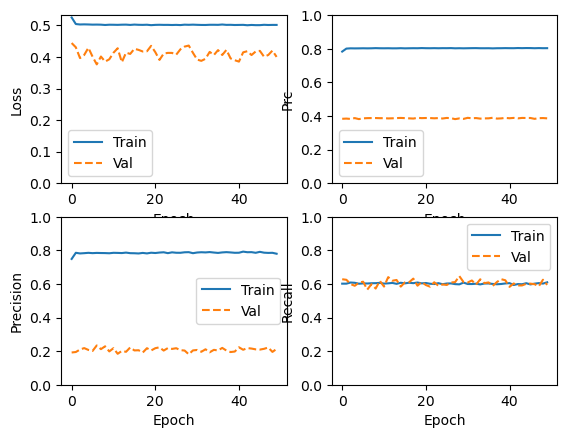

In [128]:
plot_metrics(baseline_history)

In [129]:
train_predictions = model.predict(X_train_b, batch_size=2048)
start = time.time()
test_predictions = model.predict(X_test_b, batch_size=2048)
dnn_inference_time_b = time.time() - start

58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


In [130]:
print(test_predictions)

[[0.17325966]
 [0.16075914]
 [0.15370038]
 ...
 [0.16093217]
 [0.37418553]
 [0.3785263 ]]


loss :  0.40035951137542725
compile_metrics :  1189.0

Legitimate Transactions Detected (True Negatives):  49556
Legitimate Transactions Incorrectly Detected (False Positives):  6431
Fraudulent Transactions Missed (False Negatives):  1189
Fraudulent Transactions Detected (True Positives):  1743
Total Fraudulent Transactions:  2932


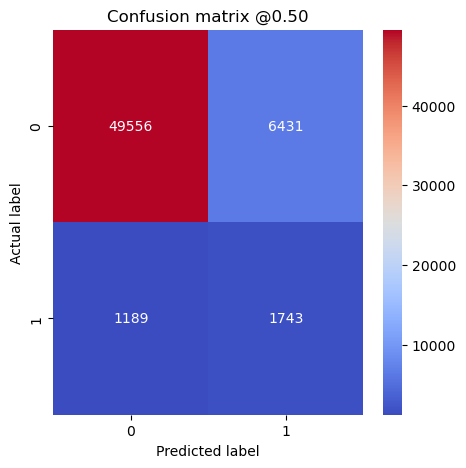

In [131]:
results = model.evaluate(X_test_b, y_test_b, batch_size=2048, verbose=0)
for name, value in zip(model.metrics_names, results):
  print(name, ': ', value)
print()
plot_cm(y_test_b, test_predictions)

Legitimate Transactions Detected (True Negatives):  36832
Legitimate Transactions Incorrectly Detected (False Positives):  19155
Fraudulent Transactions Missed (False Negatives):  518
Fraudulent Transactions Detected (True Positives):  2414
Total Fraudulent Transactions:  2932
Legitimate Transactions Detected (True Negatives):  42659
Legitimate Transactions Incorrectly Detected (False Positives):  13328
Fraudulent Transactions Missed (False Negatives):  780
Fraudulent Transactions Detected (True Positives):  2152
Total Fraudulent Transactions:  2932


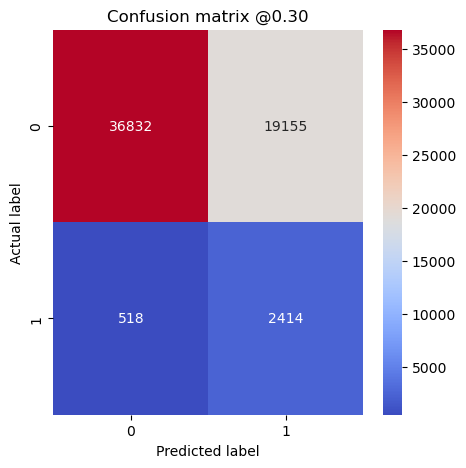

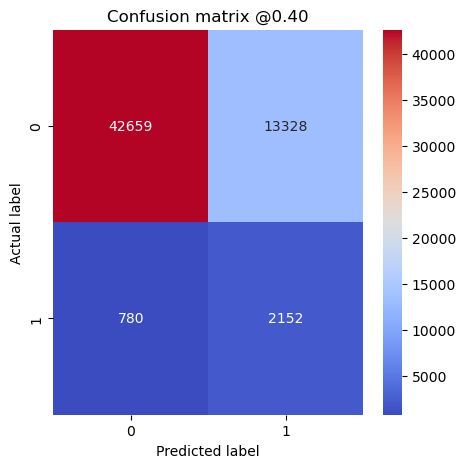

In [132]:
plot_cm(y_test_b, test_predictions, threshold=0.3)
plot_cm(y_test_b, test_predictions, threshold=0.4)

In [133]:
test_predictions.shape

(58919, 1)

In [134]:
# Get scores from various thresholds
Ts = np.round(np.linspace(.1, .9, 9),2)
Accs = []
Ps = []
Rs = []
ROCs = []
FPRs = []
TPRs = []

for t in Ts:
    a, p, r, roc, fpr, tpr = get_scores_by_threshold(y_test_b, test_predictions, thresh = t)
    Accs.append(a)
    Ps.append(p)
    Rs.append(r)
    ROCs.append(roc)
    FPRs.append(fpr)
    TPRs.append(tpr)
#    print(f'scores {round(t*100,2)}%: {a} {p} {r} {roc}')
end = time.time()

df_dict = {
    'Threshold':Ts,
    'Accuracy':Accs,
    'Precision':Ps,
    'Recall':Rs,
    'ROC':ROCs
}

dnn_df_b = pd.DataFrame(df_dict).set_index('Threshold')
dnn_df_b

,Accuracy,Precision,Recall,ROC
Threshold,,,,
0.1,0.049763,0.049763,1.000000,0.500000
0.2,0.568255,0.091602,0.860846,0.706889
0.3,0.666101,0.111920,0.823329,0.740598
0.4,0.760553,0.139018,0.733970,0.747957
0.5,0.870670,0.213237,0.594475,0.739804
0.6,0.898810,0.253338,0.530696,0.724392
0.7,0.935012,0.366874,0.421555,0.691729
0.8,0.944585,0.434320,0.375512,0.674949
0.9,0.955430,0.678738,0.198158,0.596623


# <br>4. MODELS COMPARISON AND CONCLUSION</center>

In [135]:
# Build the comparable
result = pd.DataFrame(gboost_df.T[0.3]).rename(columns = {0.3:'GBOOST SET A 30%'})
result['GBOOST SET B 30%'] = gboost_df_b.T[0.3]
result['NEURAL SET A 30%'] = dnn_df.T[0.3]
result['NEURAL SET B 30%'] = dnn_df_b.T[0.3]

result.loc['Search & Fit Time'] = [gboost_searchfit_time, gboost_searchfit_time_b, dnn_searchfit_time, dnn_searchfit_time_b]
result.loc['Inference Time'] = [gboost_inference_time, gboost_inference_time_b, dnn_inference_time,dnn_inference_time_b]

result

,GBOOST SET A 30%,GBOOST SET B 30%,NEURAL SET A 30%,NEURAL SET B 30%
Accuracy,0.678491,0.633395,0.651946,0.666101
Precision,0.113516,0.104290,0.107551,0.111920
Recall,0.799048,0.839018,0.818429,0.823329
ROC,0.735602,0.730822,0.730814,0.740598
Search & Fit Time,615.535571,147.007716,26.834135,25.441246
Inference Time,0.462115,0.083045,0.122517,0.110504


### CONCLUSION

> - With both datasets, Gradient Boosting Ensemble and Deep Neural Networks yielded the best performance for the Precision-Recall AUC metric.
> - The use of a deep neural network on the dataset B provided the best results overall.
> - Decreasing the probability threshold to 30% instead of 50% allows to capture more fraudulent orders (up to 85%) but the tradeoff is costly: the number of false positive exploses.
> - The dataset reduced to 2 principal components with PCA did not improve the performance. I tested different models with it but removed the cells from the notebook to save some space after seeing that the performance was not better.
> - The unability of all models to find a strong compromise between recall and precision - even though the datasets have been augmented and rebalanced, and the features have been engineered and selected - demonstrates the lack of patterns in the synthetic dataset. All the simple patterns baked in the synthetic dataset have been uncovered, but the remaining distribution of fraudulent transactions has been evenly spreaded on each feature, creating a noise that has no particular sense. As is, the dataset lacks more real-life features which could reveal patterns or yield informative power.